In [1]:
import pandas as pd
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from os.path import join
import scanpy as sc
import anndata
import warnings
import pickle

from abc_atlas_access.abc_atlas_cache.abc_project_cache import AbcProjectCache

# Set ABC Cache

In [2]:
download_base = Path('/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/raw_data')
abc_cache = AbcProjectCache.from_cache_dir(download_base)

abc_cache.current_manifest

'releases/20250531/manifest.json'

In [3]:
abc_cache.list_directories

['ASAP-PMDBS-10X',
 'ASAP-PMDBS-taxonomy',
 'Allen-CCF-2020',
 'HMBA-10xMultiome-BG',
 'HMBA-10xMultiome-BG-Aligned',
 'HMBA-BG-taxonomy-CCN20250428',
 'MERFISH-C57BL6J-638850',
 'MERFISH-C57BL6J-638850-CCF',
 'MERFISH-C57BL6J-638850-imputed',
 'MERFISH-C57BL6J-638850-sections',
 'SEAAD',
 'SEAAD-taxonomy',
 'WHB-10Xv3',
 'WHB-taxonomy',
 'WMB-10X',
 'WMB-10XMulti',
 'WMB-10Xv2',
 'WMB-10Xv3',
 'WMB-neighborhoods',
 'WMB-taxonomy',
 'Zeng-Aging-Mouse-10Xv3',
 'Zeng-Aging-Mouse-WMB-taxonomy',
 'Zhuang-ABCA-1',
 'Zhuang-ABCA-1-CCF',
 'Zhuang-ABCA-2',
 'Zhuang-ABCA-2-CCF',
 'Zhuang-ABCA-3',
 'Zhuang-ABCA-3-CCF',
 'Zhuang-ABCA-4',
 'Zhuang-ABCA-4-CCF']

In [4]:
abc_cache.list_metadata_files('MERFISH-C57BL6J-638850-CCF')

['ccf_coordinates',
 'cell_metadata_with_parcellation_annotation',
 'reconstructed_coordinates']

In [5]:
abc_cache.list_data_files('WMB-10Xv3')

['WMB-10Xv3-CB/log2',
 'WMB-10Xv3-CB/raw',
 'WMB-10Xv3-CTXsp/log2',
 'WMB-10Xv3-CTXsp/raw',
 'WMB-10Xv3-HPF/log2',
 'WMB-10Xv3-HPF/raw',
 'WMB-10Xv3-HY/log2',
 'WMB-10Xv3-HY/raw',
 'WMB-10Xv3-Isocortex-1/log2',
 'WMB-10Xv3-Isocortex-1/raw',
 'WMB-10Xv3-Isocortex-2/log2',
 'WMB-10Xv3-Isocortex-2/raw',
 'WMB-10Xv3-MB/log2',
 'WMB-10Xv3-MB/raw',
 'WMB-10Xv3-MY/log2',
 'WMB-10Xv3-MY/raw',
 'WMB-10Xv3-OLF/log2',
 'WMB-10Xv3-OLF/raw',
 'WMB-10Xv3-P/log2',
 'WMB-10Xv3-P/raw',
 'WMB-10Xv3-PAL/log2',
 'WMB-10Xv3-PAL/raw',
 'WMB-10Xv3-STR/log2',
 'WMB-10Xv3-STR/raw',
 'WMB-10Xv3-TH/log2',
 'WMB-10Xv3-TH/raw']

In [6]:
abc_cache.list_data_files('MERFISH-C57BL6J-638850')

['C57BL6J-638850/log2', 'C57BL6J-638850/raw']

# Load WMB MERFISH data

In [7]:
# load merfish data
file_path = abc_cache.get_data_path(directory='MERFISH-C57BL6J-638850', file_name='C57BL6J-638850/log2')
mf_adata = sc.read_h5ad(file_path)
mf_adata

AnnData object with n_obs × n_vars = 4334174 × 550
    obs: 'brain_section_label'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src'

In [8]:
# cell meta data (ccf registered)
cell_meta = abc_cache.get_metadata_dataframe(
    directory='MERFISH-C57BL6J-638850-CCF',
    file_name='cell_metadata_with_parcellation_annotation',
    index_col='cell_label',
    dtype={'cell_label': str}
)
print(len(cell_meta))
cell_meta

3739961


,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_organ,parcellation_category,parcellation_division,parcellation_structure,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color
cell_label,,,,,,,,,,,,,,,,,,,,,
1019171907102340387-1,C57BL6J-638850.37,1408,0.596276,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.226245,4.148963,6.6,...,brain,grey,HPF,DG,DG-po,#FFFFFF,#BFDAE3,#7ED04B,#7ED04B,#7ED04B
1104095349101460194-1,C57BL6J-638850.26,4218,0.641180,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.064889,7.309543,4.2,...,brain,grey,P,TRN,TRN,#FFFFFF,#BFDAE3,#FF9B88,#FFBA86,#FFBA86
1017092617101450577,C57BL6J-638850.25,4218,0.763531,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.792921,8.189973,4.0,...,brain,grey,P,P-unassigned,P-unassigned,#FFFFFF,#BFDAE3,#FF9B88,#FF9B88,#FF9B88
1018093344101130233,C57BL6J-638850.13,4218,0.558073,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.195950,5.868655,2.4,...,brain,fiber tracts,cbf,arb,arb,#FFFFFF,#CCCCCC,#CCCCCC,#CCCCCC,#CCCCCC
1019171912201610094,C57BL6J-638850.27,4218,0.591009,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.635732,7.995842,4.4,...,brain,grey,P,P-unassigned,P-unassigned,#FFFFFF,#BFDAE3,#FF9B88,#FF9B88,#FF9B88
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018093344100380167-3,C57BL6J-638850.47,5252,0.574988,C57BL6J-638850,C57BL6J-638850,wt/wt,M,1.560003,4.669243,8.8,...,brain,grey,Isocortex,SSp-n,SSp-n2/3,#FFFFFF,#BFDAE3,#70FF71,#188064,#188064
1017165415100930567,C57BL6J-638850.57,5254,0.620546,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.032556,3.695696,11.0,...,brain,grey,Isocortex,ACAd,ACAd5,#FFFFFF,#BFDAE3,#70FF71,#40A666,#40A666
1017155956102610748,C57BL6J-638850.49,5254,0.548053,C57BL6J-638850,C57BL6J-638850,wt/wt,M,2.549142,4.231188,9.2,...,brain,grey,Isocortex,SSp-m,SSp-m6a,#FFFFFF,#BFDAE3,#70FF71,#188064,#188064


In [9]:
# get intersected indexes
valid_index = mf_adata.obs.index.intersection(cell_meta.index)
mf_adata = mf_adata[valid_index].copy()
mf_adata

AnnData object with n_obs × n_vars = 3739961 × 550
    obs: 'brain_section_label'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src'

In [10]:
# add cell meta to adata (reoder the adata indexes)
mf_adata.obs = cell_meta.loc[mf_adata.obs.index].copy()
mf_adata

AnnData object with n_obs × n_vars = 3739961 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src'

In [11]:
# add coordinates to obsm.spatial
mf_adata.obsm['spatial'] = mf_adata.obs[['x_section', 'y_section', 'z_section']].copy().to_numpy()
mf_adata

AnnData object with n_obs × n_vars = 3739961 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src'
    obsm: 'spatial'

In [12]:
from utils import set_color_palettes
set_color_palettes(mf_adata, do_parcellation=True)
mf_adata

AnnData object with n_obs × n_vars = 3739961 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette',

# Screen MERFISH Sections

In [13]:
np.sort(cell_meta['brain_section_label'].unique())

array(['C57BL6J-638850.05', 'C57BL6J-638850.06', 'C57BL6J-638850.08',
       'C57BL6J-638850.09', 'C57BL6J-638850.10', 'C57BL6J-638850.11',
       'C57BL6J-638850.12', 'C57BL6J-638850.13', 'C57BL6J-638850.14',
       'C57BL6J-638850.15', 'C57BL6J-638850.16', 'C57BL6J-638850.17',
       'C57BL6J-638850.18', 'C57BL6J-638850.19', 'C57BL6J-638850.24',
       'C57BL6J-638850.25', 'C57BL6J-638850.26', 'C57BL6J-638850.27',
       'C57BL6J-638850.28', 'C57BL6J-638850.29', 'C57BL6J-638850.30',
       'C57BL6J-638850.31', 'C57BL6J-638850.32', 'C57BL6J-638850.33',
       'C57BL6J-638850.35', 'C57BL6J-638850.36', 'C57BL6J-638850.37',
       'C57BL6J-638850.38', 'C57BL6J-638850.39', 'C57BL6J-638850.40',
       'C57BL6J-638850.42', 'C57BL6J-638850.43', 'C57BL6J-638850.44',
       'C57BL6J-638850.45', 'C57BL6J-638850.46', 'C57BL6J-638850.47',
       'C57BL6J-638850.48', 'C57BL6J-638850.49', 'C57BL6J-638850.50',
       'C57BL6J-638850.51', 'C57BL6J-638850.52', 'C57BL6J-638850.54',
       'C57BL6J-6388

In [14]:
mf_adata

AnnData object with n_obs × n_vars = 3739961 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette',

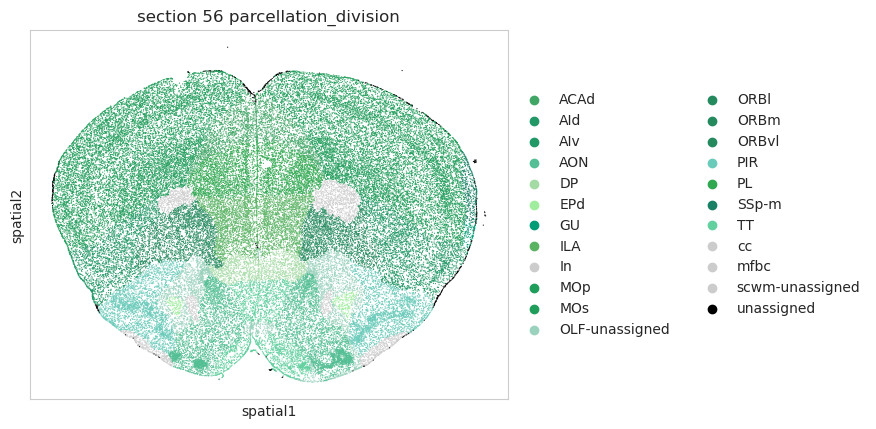

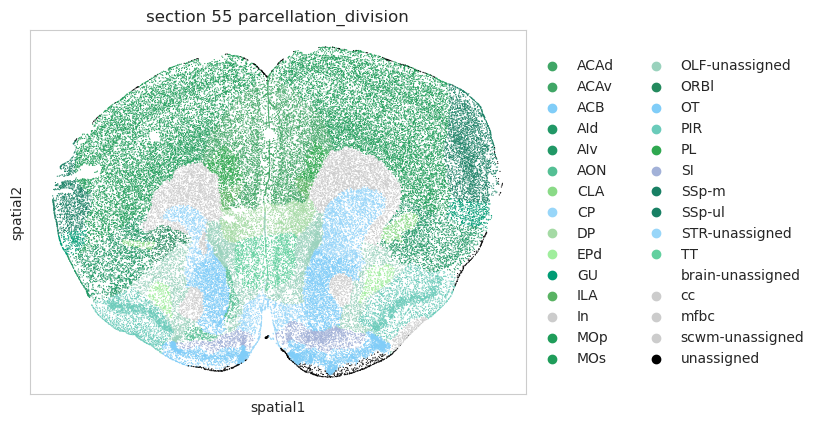

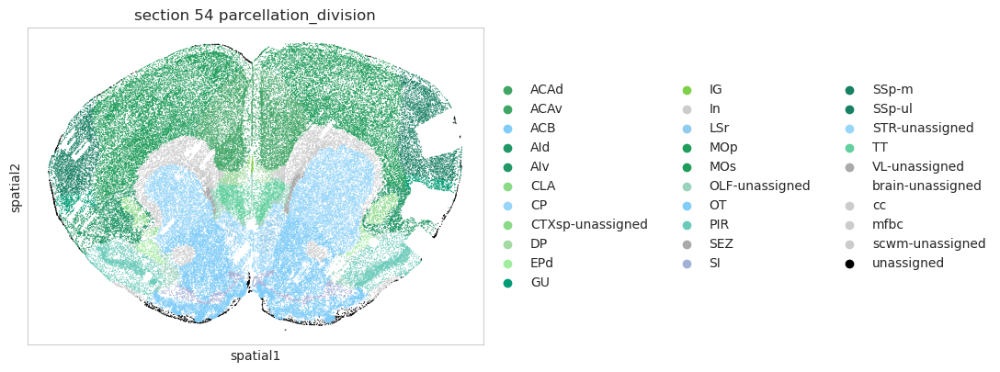

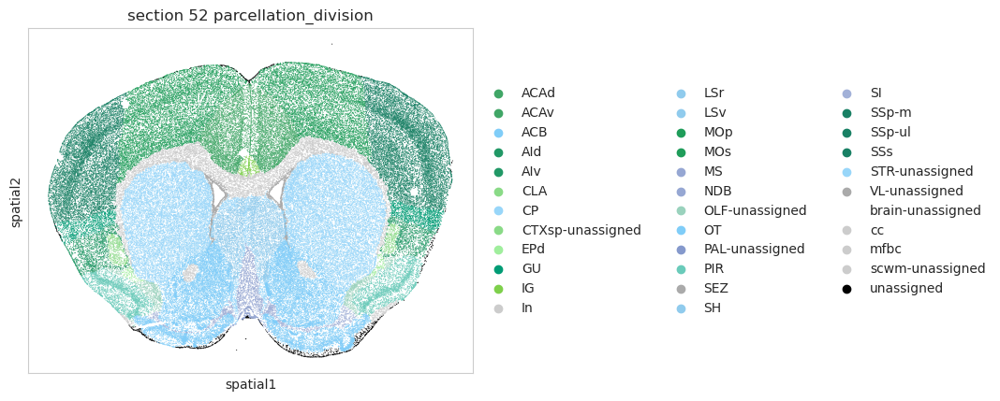

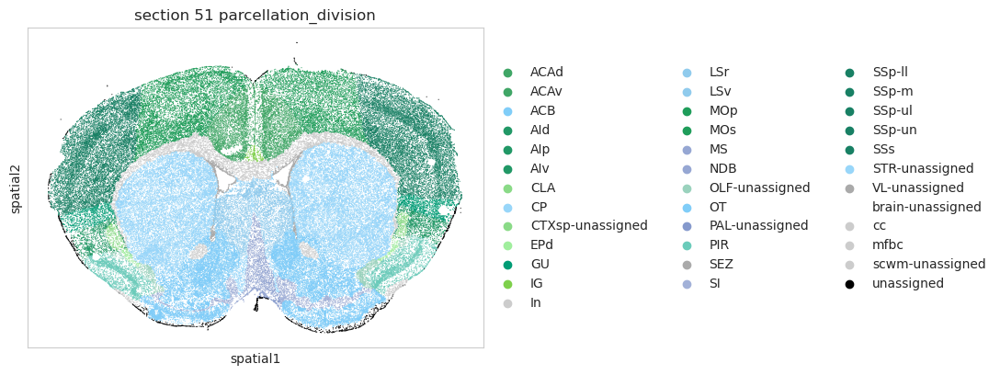

...

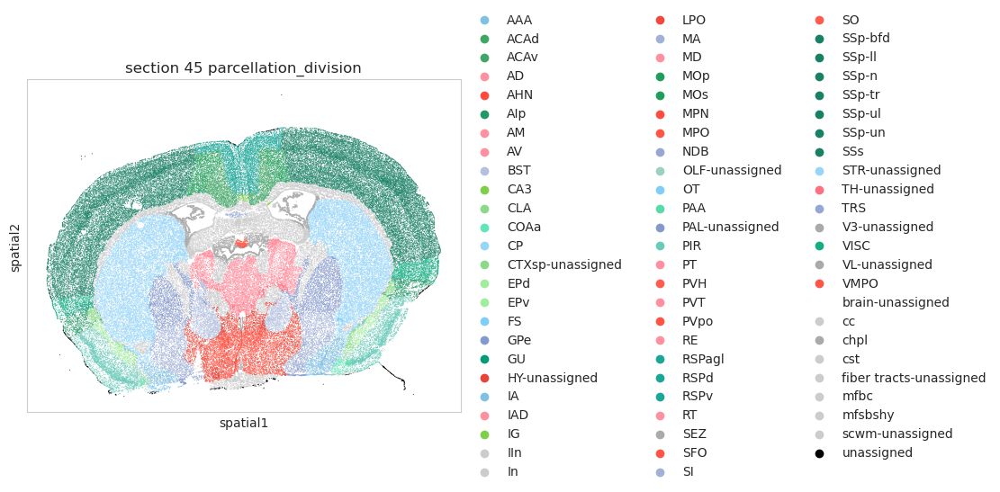

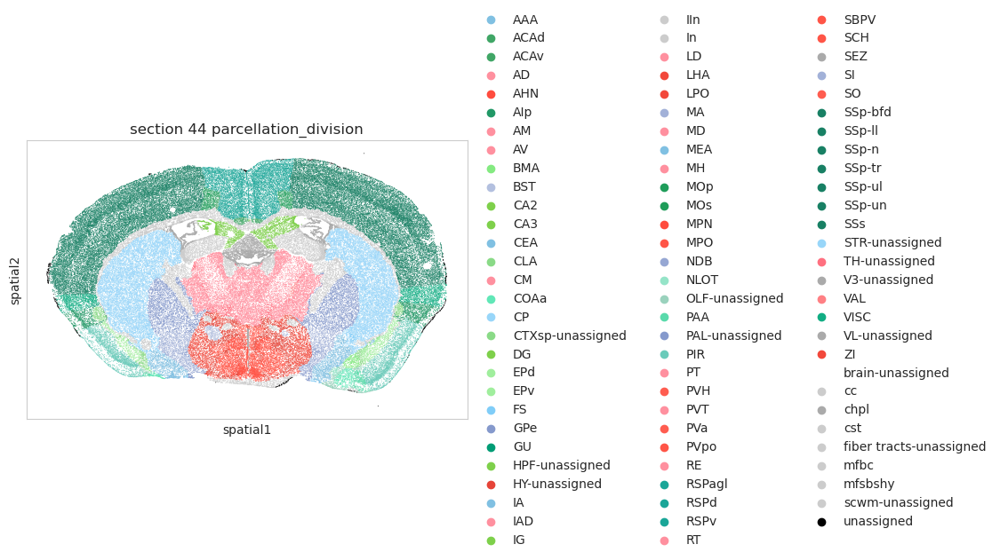

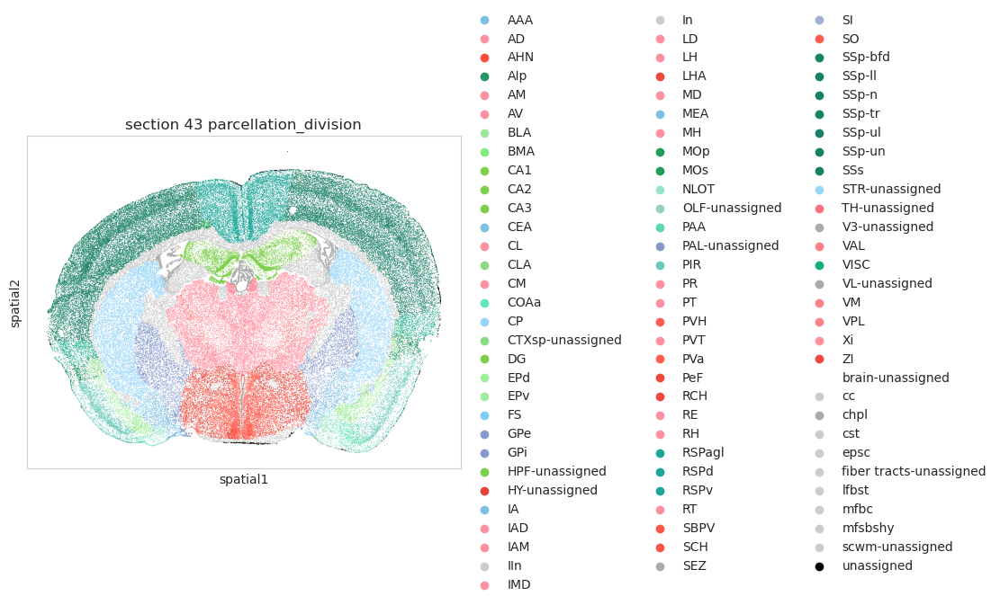

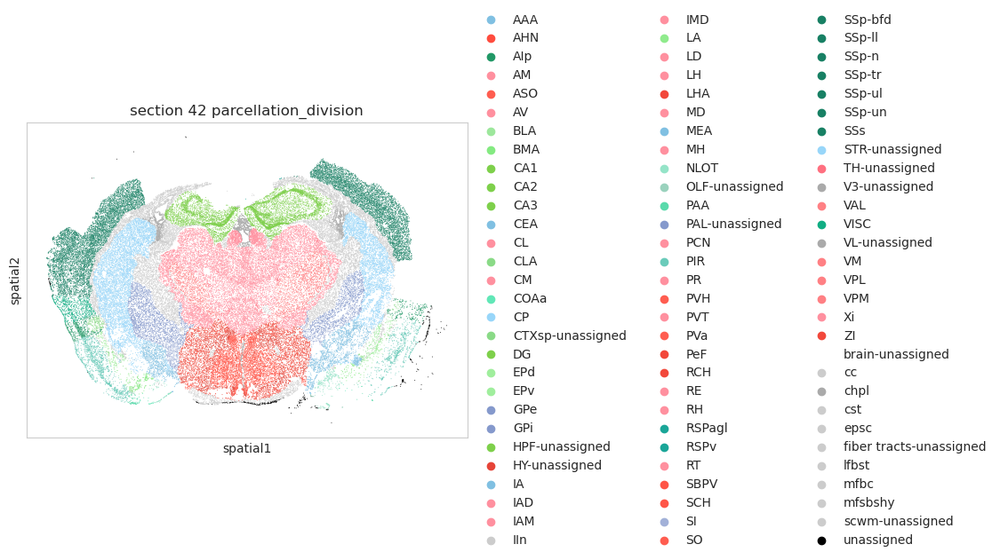

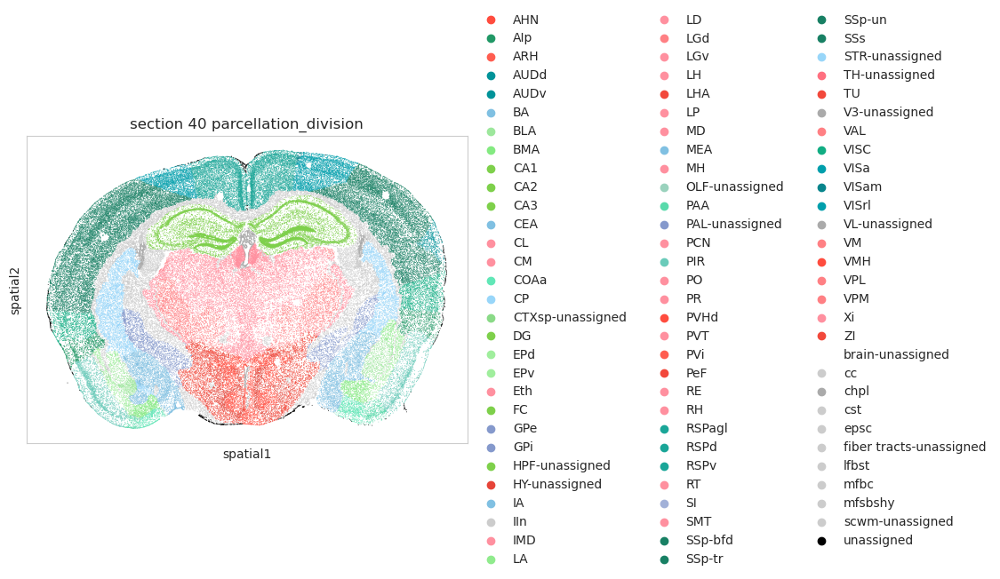

In [15]:
warnings.filterwarnings('ignore')

# plot sections
section_list = [56, 55, 54, 52, 51, 50, 49, 48, 47, 46, 45, 44, 43, 42, 40]

for sec in section_list:
    section_label = 'C57BL6J-638850.{}'.format(sec)

    mf_bg_adata = mf_adata[mf_adata.obs['brain_section_label'] == section_label].copy()
    sc.pl.spatial(mf_bg_adata, color='parcellation_structure', palette = mf_bg_adata.uns['parcellation_structure_palette'], spot_size=0.02, title=['section {} parcellation_division'.format(sec), 'section {} parcellation_structure'.format(sec)])


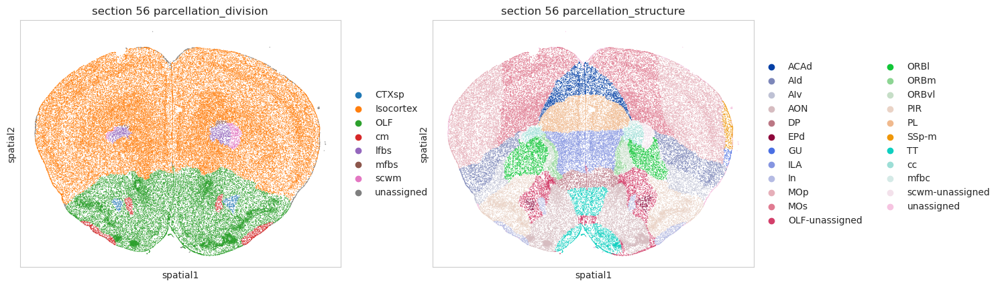

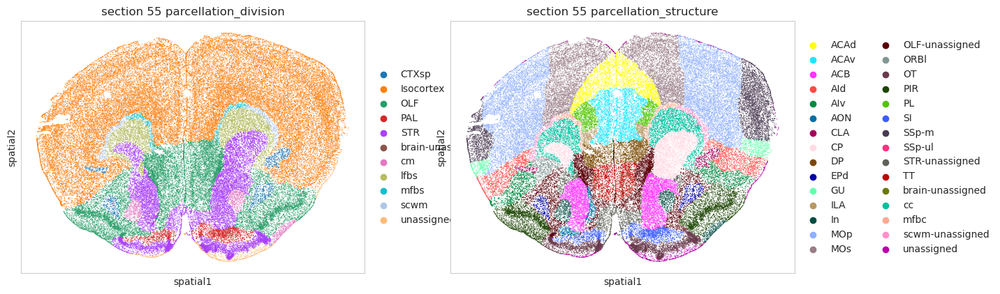

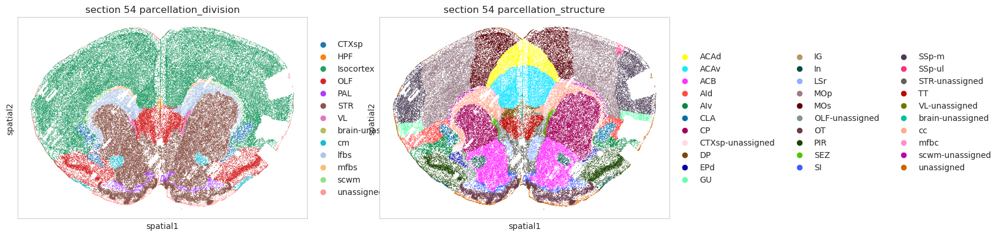

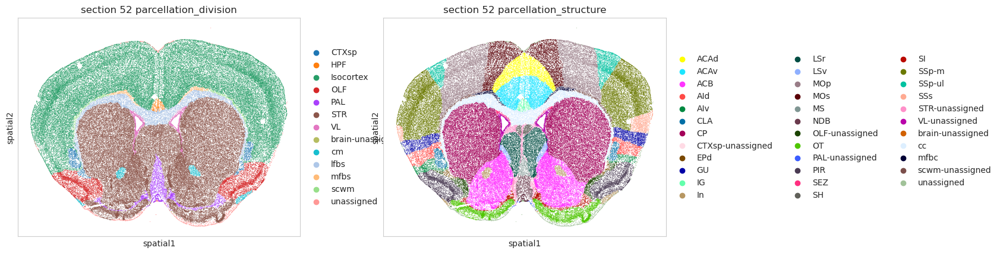

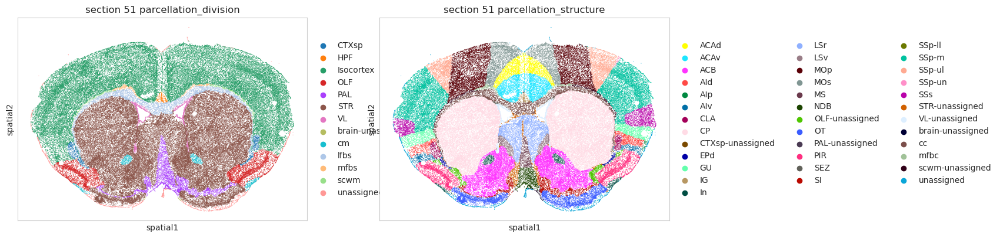

...

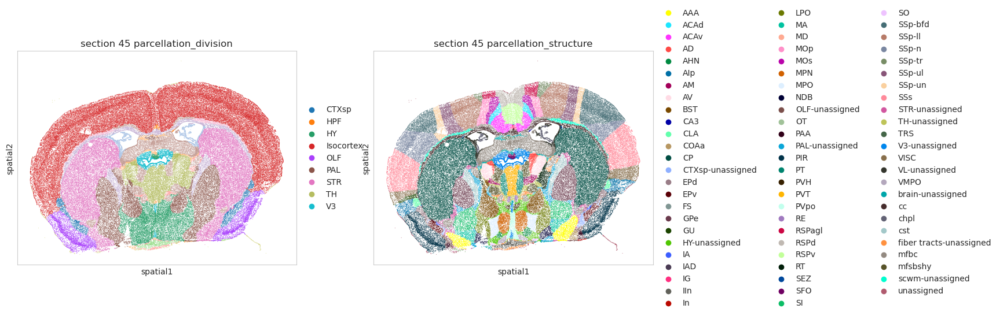

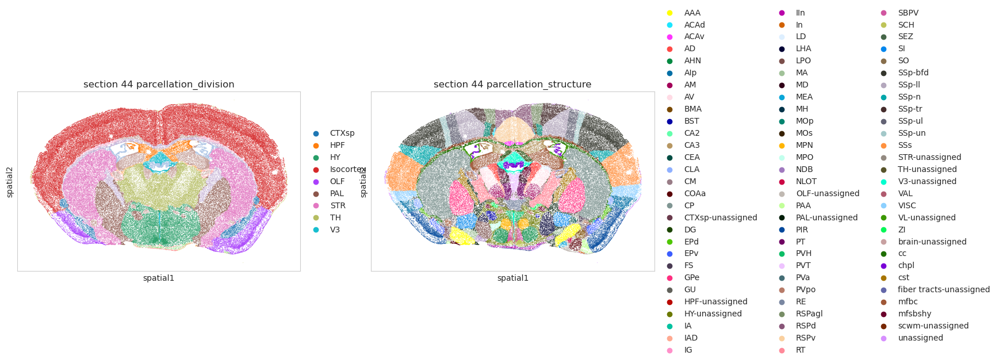

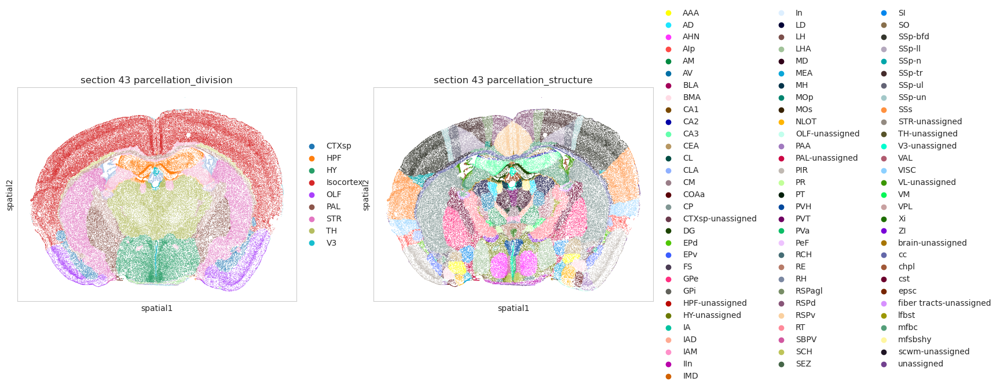

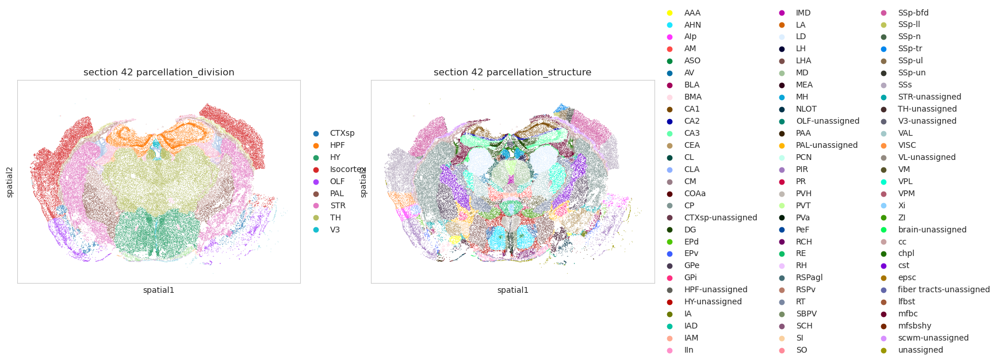

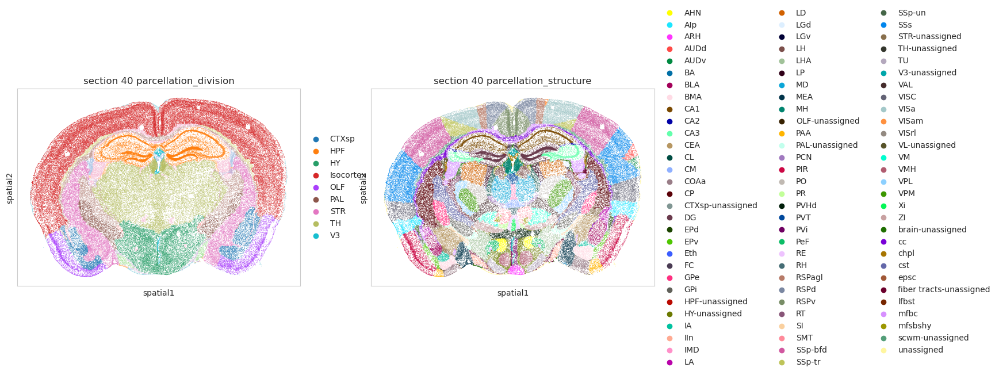

In [16]:
warnings.filterwarnings('ignore')

# plot sections
section_list = [56, 55, 54, 52, 51, 50, 49, 48, 47, 46, 45, 44, 43, 42, 40]

for sec in section_list:
    section_label = 'C57BL6J-638850.{}'.format(sec)

    mf_bg_adata = mf_adata[mf_adata.obs['brain_section_label'] == section_label].copy()
    sc.pl.spatial(mf_bg_adata, color=['parcellation_division', 'parcellation_structure'], spot_size=0.02, title=['section {} parcellation_division'.format(sec), 'section {} parcellation_structure'.format(sec)])


In [17]:
section_list

[56, 55, 54, 52, 51, 50, 49, 48, 47, 46, 45, 44, 43, 42, 40]

In [18]:
mf_bg_adata = mf_adata[mf_adata.obs['parcellation_division'].isin(['STR', 'PAL'])].copy()
mf_bg_adata

AnnData object with n_obs × n_vars = 479231 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 

In [19]:
mf_bg_adata.obs

,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_organ,parcellation_category,parcellation_division,parcellation_structure,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color
cell_label,,,,,,,,,,,,,,,,,,,,,
1018093344101090574-5,C57BL6J-638850.35,14930,0.521895,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.534266,7.067371,6.2,...,brain,grey,STR,MEA,MEA,#FFFFFF,#BFDAE3,#98D6F9,#80C0E2,#80C0E2
1018093344101100489-5,C57BL6J-638850.35,2762,0.676341,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.209255,7.459818,6.2,...,brain,grey,STR,MEA,MEA,#FFFFFF,#BFDAE3,#98D6F9,#80C0E2,#80C0E2
1018093344102340306-5,C57BL6J-638850.35,14930,0.562540,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.623325,7.724096,6.2,...,brain,grey,STR,MEA,MEA,#FFFFFF,#BFDAE3,#98D6F9,#80C0E2,#80C0E2
1018093344101100428-5,C57BL6J-638850.35,2762,0.534415,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.240080,7.487704,6.2,...,brain,grey,STR,MEA,MEA,#FFFFFF,#BFDAE3,#98D6F9,#80C0E2,#80C0E2
1018093344101100299-5,C57BL6J-638850.35,2762,0.599165,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.278312,7.584932,6.2,...,brain,grey,STR,MEA,MEA,#FFFFFF,#BFDAE3,#98D6F9,#80C0E2,#80C0E2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018135614101830105,C57BL6J-638850.55,5252,0.573846,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.044830,7.785608,10.4,...,brain,grey,PAL,SI,SI,#FFFFFF,#BFDAE3,#8599CC,#A2B1D8,#A2B1D8
1018135614101480565,C57BL6J-638850.55,5252,0.501385,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.724380,7.013436,10.4,...,brain,grey,STR,ACB,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8
1018135614102200361,C57BL6J-638850.55,5254,0.528639,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.155551,8.096663,10.4,...,brain,grey,STR,OT,OT,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8


# Select BG cell types

In [20]:
np.sort(mf_bg_adata.obs['class'].unique())

array(['01 IT-ET Glut', '02 NP-CT-L6b Glut', '03 OB-CR Glut',
       '04 DG-IMN Glut', '05 OB-IMN GABA', '06 CTX-CGE GABA',
       '07 CTX-MGE GABA', '08 CNU-MGE GABA', '09 CNU-LGE GABA',
       '10 LSX GABA', '11 CNU-HYa GABA', '12 HY GABA', '13 CNU-HYa Glut',
       '14 HY Glut', '15 HY Gnrh1 Glut', '18 TH Glut', '19 MB Glut',
       '20 MB GABA', '23 P Glut', '24 MY Glut', '27 MY GABA',
       '28 CB GABA', '29 CB Glut', '30 Astro-Epen', '31 OPC-Oligo',
       '33 Vascular', '34 Immune'], dtype=object)

In [21]:
len(mf_bg_adata.obs['class'].unique())

27

In [22]:
np.sort(mf_bg_adata.obs['subclass'].unique())

array(['001 CLA-EPd-CTX Car3 Glut', '002 IT EP-CLA Glut',
       '003 L5/6 IT TPE-ENT Glut', '004 L6 IT CTX Glut',
       '005 L5 IT CTX Glut', '006 L4/5 IT CTX Glut',
       '007 L2/3 IT CTX Glut', '008 L2/3 IT ENT Glut',
       '009 L2/3 IT PIR-ENTl Glut', '010 IT AON-TT-DP Glut',
       '012 MEA Slc17a7 Glut', '013 COAp Grxcr2 Glut',
       '014 LA-BLA-BMA-PA Glut', '016 CA1-ProS Glut', '017 CA3 Glut',
       '022 L5 ET CTX Glut', '023 SUB-ProS Glut', '025 CA2-FC-IG Glut',
       '026 NLOT Rho Glut', '027 L6b EPd Glut', '028 L6b/CT ENT Glut',
       '029 L6b CTX Glut', '030 L6 CT CTX Glut', '032 L5 NP CTX Glut',
       '033 NP SUB Glut', '035 OB Eomes Ms4a15 Glut', '036 HPF CR Glut',
       '037 DG Glut', '038 DG-PIR Ex IMN', '039 OB Meis2 Thsd7b Gaba',
       '040 OB Trdn Gaba', '041 OB-in Frmd7 Gaba',
       '042 OB-out Frmd7 Gaba', '043 OB-mi Frmd7 Gaba',
       '044 OB Dopa-Gaba', '045 OB-STR-CTX Inh IMN', '046 Vip Gaba',
       '047 Sncg Gaba', '048 RHP-COA Ndnf Gaba', '049 Lam

In [23]:
len(mf_bg_adata.obs['subclass'].unique())

151

In [24]:
np.sort(mf_bg_adata.obs['supertype'].unique())

array(['0001 CLA-EPd-CTX Car3 Glut_1', '0002 CLA-EPd-CTX Car3 Glut_2',
       '0003 IT EP-CLA Glut_1', '0004 IT EP-CLA Glut_2',
       '0005 IT EP-CLA Glut_3', '0006 IT EP-CLA Glut_4',
       '0007 L5/6 IT TPE-ENT Glut_1', '0008 L5/6 IT TPE-ENT Glut_2',
       '0013 L6 IT CTX Glut_1', '0014 L6 IT CTX Glut_2',
       '0015 L6 IT CTX Glut_3', '0016 L6 IT CTX Glut_4',
       '0017 L6 IT CTX Glut_5', '0020 L5 IT CTX Glut_3',
       '0023 L4/5 IT CTX Glut_1', '0026 L4/5 IT CTX Glut_4',
       '0030 L2/3 IT CTX Glut_2', '0031 L2/3 IT CTX Glut_3',
       '0035 L2/3 IT ENT Glut_3', '0039 L2/3 IT PIR-ENTl Glut_1',
       '0040 L2/3 IT PIR-ENTl Glut_2', '0041 L2/3 IT PIR-ENTl Glut_3',
       '0042 L2/3 IT PIR-ENTl Glut_4', '0043 L2/3 IT PIR-ENTl Glut_5',
       '0044 L2/3 IT PIR-ENTl Glut_6', '0045 L2/3 IT PIR-ENTl Glut_7',
       '0046 IT AON-TT-DP Glut_1', '0047 IT AON-TT-DP Glut_2',
       '0049 IT AON-TT-DP Glut_4', '0050 IT AON-TT-DP Glut_5',
       '0055 MEA Slc17a7 Glut_1', '0056 MEA Slc1

In [25]:
len(mf_bg_adata.obs['supertype'].unique())

525

In [26]:
print(mf_bg_adata.obs['supertype'].value_counts()[:20])

supertype
0277 STR D2 Gaba_4           68538
0267 STR D1 Gaba_3           48547
1184 MOL NN_4                43815
1163 Astro-TE NN_3           32363
1193 Endo NN_1               27515
0275 STR D2 Gaba_2           23535
0268 STR D1 Gaba_4           21179
0270 STR D1 Gaba_6           15727
1160 Astro-NT NN_2           12070
0272 STR D1 Gaba_8            7279
1194 Microglia NN_1           7010
1180 OPC NN_2                 5793
1191 Peri NN_1                5431
0265 STR D1 Gaba_1            5377
0264 OT D3 Folh1 Gaba_3       5155
0262 OT D3 Folh1 Gaba_1       4753
0278 STR D2 Gaba_5            4519
1161 Astro-TE NN_1            4040
0266 STR D1 Gaba_2            3972
0287 STR-PAL Chst9 Gaba_3     3642
Name: count, dtype: int64


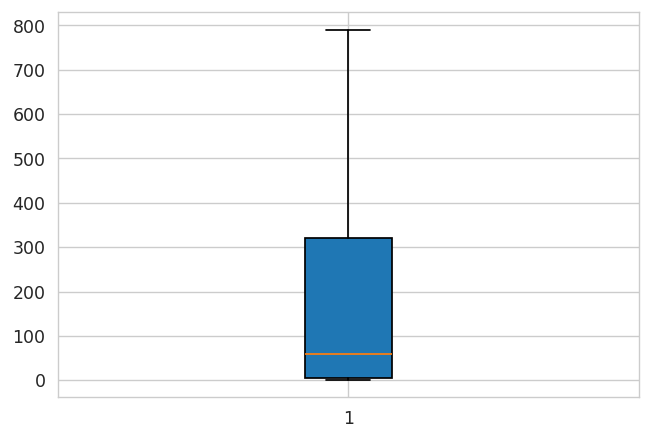

In [27]:
# supertype coutns distribution
fig, ax = plt.subplots(figsize=(6, 4), dpi=125)
ax.boxplot(mf_bg_adata.obs['supertype'].value_counts(), showfliers=False, patch_artist=True)
fig.show()

In [39]:
n_cells_thred = 200
stype_counts = mf_bg_adata.obs['supertype'].value_counts()
filter_ctypes = list(stype_counts[stype_counts > n_cells_thred].index)
print(len(filter_ctypes))
np.unique(filter_ctypes)

168


array(['0014 L6 IT CTX Glut_2', '0045 L2/3 IT PIR-ENTl Glut_7',
       '0055 MEA Slc17a7 Glut_1', '0056 MEA Slc17a7 Glut_2',
       '0057 MEA Slc17a7 Glut_3', '0062 LA-BLA-BMA-PA Glut_3',
       '0118 L6 CT CTX Glut_5', '0136 DG Glut_1',
       '0166 OB-STR-CTX Inh IMN_1', '0169 OB-STR-CTX Inh IMN_4',
       '0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
       '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2',
       '0238 Sst Chodl Gaba_1', '0239 Sst Chodl Gaba_2',
       '0240 Sst Chodl Gaba_3', '0244 NDB-SI-MA-STRv Lhx8 Gaba_1',
       '0245 NDB-SI-MA-STRv Lhx8 Gaba_2',
       '0246 NDB-SI-MA-STRv Lhx8 Gaba_3',
       '0247 NDB-SI-MA-STRv Lhx8 Gaba_4',
       '0248 NDB-SI-MA-STRv Lhx8 Gaba_5',
       '0249 NDB-SI-MA-STRv Lhx8 Gaba_6',
       '0250 NDB-SI-MA-STRv Lhx8 Gaba_7',
       '0251 NDB-SI-MA-STRv Lhx8 Gaba_8',
       '0253 NDB-SI-MA-STRv Lhx8 Gaba_10',
       '0254 NDB-SI-MA-STRv Lhx8 Gaba_11',
       '0257 GPe-SI Sox6 Cyp26b1 Gaba_1',
       '0258 GPe-SI Sox6 Cyp26b1 Gaba_

In [31]:
np.sort(np.unique(mf_bg_adata.obs['supertype']))

array(['0001 CLA-EPd-CTX Car3 Glut_1', '0002 CLA-EPd-CTX Car3 Glut_2',
       '0003 IT EP-CLA Glut_1', '0004 IT EP-CLA Glut_2',
       '0005 IT EP-CLA Glut_3', '0006 IT EP-CLA Glut_4',
       '0007 L5/6 IT TPE-ENT Glut_1', '0008 L5/6 IT TPE-ENT Glut_2',
       '0013 L6 IT CTX Glut_1', '0014 L6 IT CTX Glut_2',
       '0015 L6 IT CTX Glut_3', '0016 L6 IT CTX Glut_4',
       '0017 L6 IT CTX Glut_5', '0020 L5 IT CTX Glut_3',
       '0023 L4/5 IT CTX Glut_1', '0026 L4/5 IT CTX Glut_4',
       '0030 L2/3 IT CTX Glut_2', '0031 L2/3 IT CTX Glut_3',
       '0035 L2/3 IT ENT Glut_3', '0039 L2/3 IT PIR-ENTl Glut_1',
       '0040 L2/3 IT PIR-ENTl Glut_2', '0041 L2/3 IT PIR-ENTl Glut_3',
       '0042 L2/3 IT PIR-ENTl Glut_4', '0043 L2/3 IT PIR-ENTl Glut_5',
       '0044 L2/3 IT PIR-ENTl Glut_6', '0045 L2/3 IT PIR-ENTl Glut_7',
       '0046 IT AON-TT-DP Glut_1', '0047 IT AON-TT-DP Glut_2',
       '0049 IT AON-TT-DP Glut_4', '0050 IT AON-TT-DP Glut_5',
       '0055 MEA Slc17a7 Glut_1', '0056 MEA Slc1

In [40]:
# outlier cell types
outlier_ctypes = [
    '0014 L6 IT CTX Glut_2',
    '0045 L2/3 IT PIR-ENTl Glut_7',
    '0062 LA-BLA-BMA-PA Glut_3',
    '0118 L6 CT CTX Glut_5',
    '0136 DG Glut_1',
]

for t in outlier_ctypes:
    print(t, ' | ', np.sum(mf_bg_adata.obs['supertype']==t).item())

0014 L6 IT CTX Glut_2  |  232
0045 L2/3 IT PIR-ENTl Glut_7  |  443
0062 LA-BLA-BMA-PA Glut_3  |  250
0118 L6 CT CTX Glut_5  |  531
0136 DG Glut_1  |  299


In [45]:
# remove outlier cell types
new_filter_ctypes = []
for t in filter_ctypes:
    if t in outlier_ctypes:
        continue
    new_filter_ctypes.append(t)
filter_ctypes = new_filter_ctypes
len(filter_ctypes)

163

In [42]:
mf_bg_adata

AnnData object with n_obs × n_vars = 479231 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 

In [46]:
mf_bg_adata = mf_bg_adata[mf_bg_adata.obs['supertype'].isin(filter_ctypes)].copy()
mf_bg_adata

AnnData object with n_obs × n_vars = 462506 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 

In [48]:
# save the results
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_cell_types_20251005.pkl'), 'wb') as f:
    pickle.dump(filter_ctypes, f)

# Subset WMB MERFISH sec50 BG data

In [49]:
sec50_adata = mf_bg_adata[mf_bg_adata.obs['brain_section_label'] == 'C57BL6J-638850.50'].copy()
sec50_adata

AnnData object with n_obs × n_vars = 44848 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', '

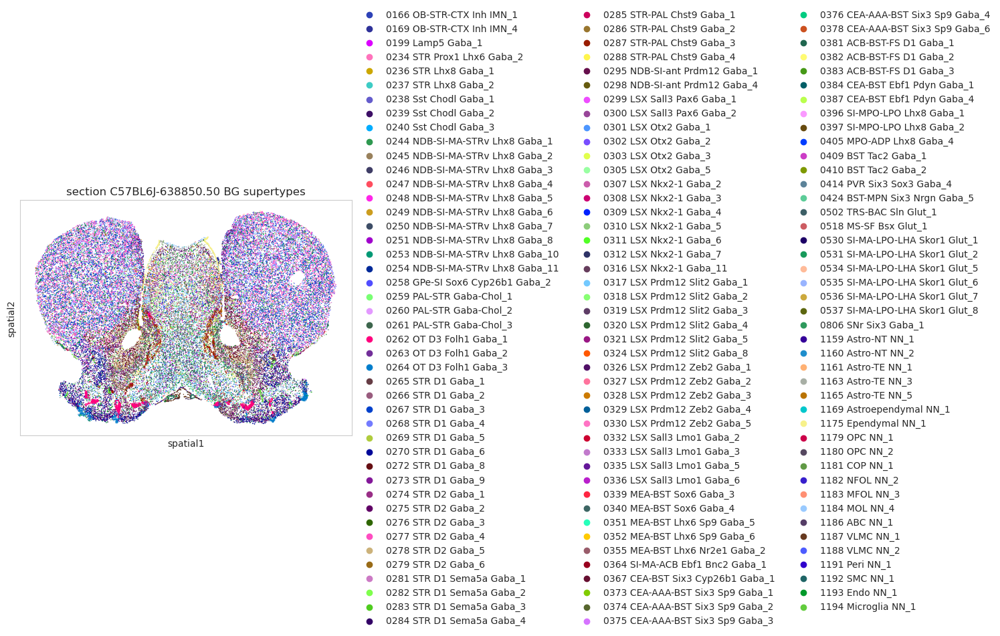

In [50]:
# plot
sc.pl.spatial(sec50_adata, color='supertype', spot_size=0.02, palette=mf_adata.uns['supertype_palette'], title=['section C57BL6J-638850.50 BG supertypes'])

In [51]:
# split 0277 STR D2 Gaba_4
np.sort(sec50_adata[sec50_adata.obs['supertype']=='0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [52]:
len(np.sort(sec50_adata.obs['supertype'].cat.categories))

131

In [53]:
# add new category items
sec50_adata.obs['supertype'] = sec50_adata.obs['supertype'].cat.add_categories(['0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*'])
sec50_adata.obs['supertype'].cat.categories

Index(['0166 OB-STR-CTX Inh IMN_1', '0169 OB-STR-CTX Inh IMN_4',
       '0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
       '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       '0244 NDB-SI-MA-STRv Lhx8 Gaba_1',
       ...
       '1184 MOL NN_4', '1186 ABC NN_1', '1187 VLMC NN_1', '1188 VLMC NN_2',
       '1191 Peri NN_1', '1192 SMC NN_1', '1193 Endo NN_1',
       '1194 Microglia NN_1', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*'],
      dtype='object', length=133)

In [54]:
# reorder the category items
sec50_adata.obs['supertype'] = sec50_adata.obs['supertype'].cat.reorder_categories(np.sort(sec50_adata.obs['supertype'].cat.categories), ordered=True)
sec50_adata.obs['supertype'].cat.categories

Index(['0166 OB-STR-CTX Inh IMN_1', '0169 OB-STR-CTX Inh IMN_4',
       '0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
       '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       '0244 NDB-SI-MA-STRv Lhx8 Gaba_1',
       ...
       '1182 NFOL NN_2', '1183 MFOL NN_3', '1184 MOL NN_4', '1186 ABC NN_1',
       '1187 VLMC NN_1', '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype='object', length=133)

In [55]:
len(np.sort(sec50_adata.obs['supertype'].cat.categories))

133

In [56]:
sec50_adata.obs.loc[sec50_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
sec50_adata.obs.loc[sec50_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [57]:
# update color palette
# according to spatial human BG color palette, others using wmb's palette

# 'STRd D1 Striosome MSN': '#00f3f7ff',
# 'STRd D1 Matrix MSN': '#3e0aaeff',
# 'STRd D2 Striosome MSN': '#06b374ff'
# 'STRd D2 Matrix MSN': '#8e0537ff',

sec50_adata.uns['supertype_palette']['0268 STR D1 Gaba_4'] = '#00f3f7ff'
sec50_adata.uns['supertype_palette']['0267 STR D1 Gaba_3'] = '#3e0aaeff'
sec50_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_A*'] = '#06b374ff'
sec50_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_B*'] = '#8e0537ff'

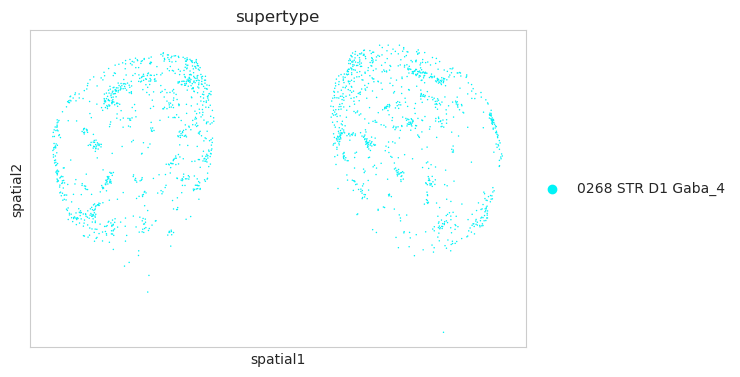

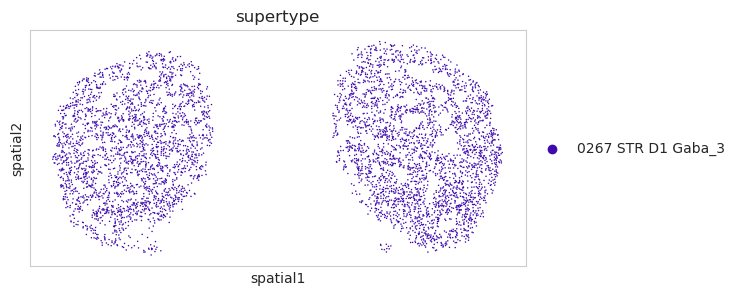

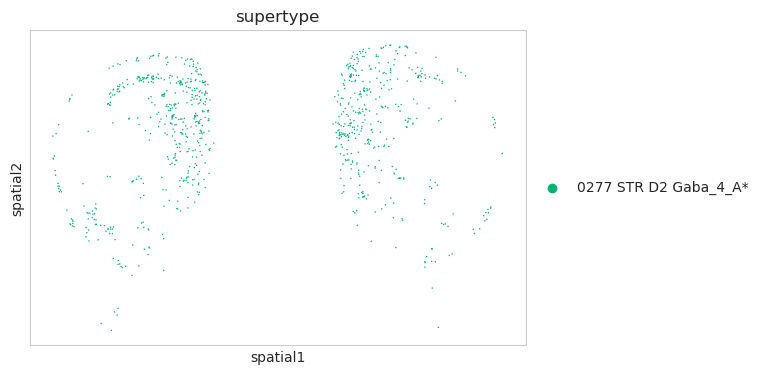

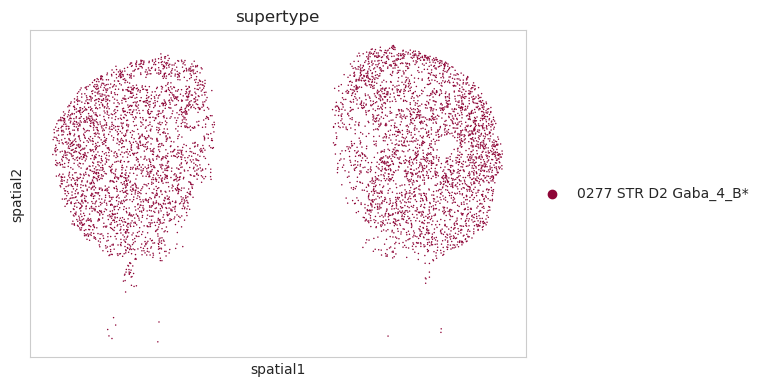

In [58]:
temp_list = ['0268 STR D1 Gaba_4', '0267 STR D1 Gaba_3', '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*']

for temp in temp_list:
    sc.pl.spatial(sec50_adata[sec50_adata.obs['supertype']==temp], color='supertype', spot_size=0.02, palette=sec50_adata.uns['supertype_palette'])

In [59]:
# save the data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_mf_sec50_20251005.pkl'), 'wb') as f:
    pickle.dump(sec50_adata, f)

# Subset WMB MERFISH sec49 BG data

In [60]:
sec49_adata = mf_bg_adata[mf_bg_adata.obs['brain_section_label'] == 'C57BL6J-638850.49']
sec49_adata

View of AnnData object with n_obs × n_vars = 50986 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_pal

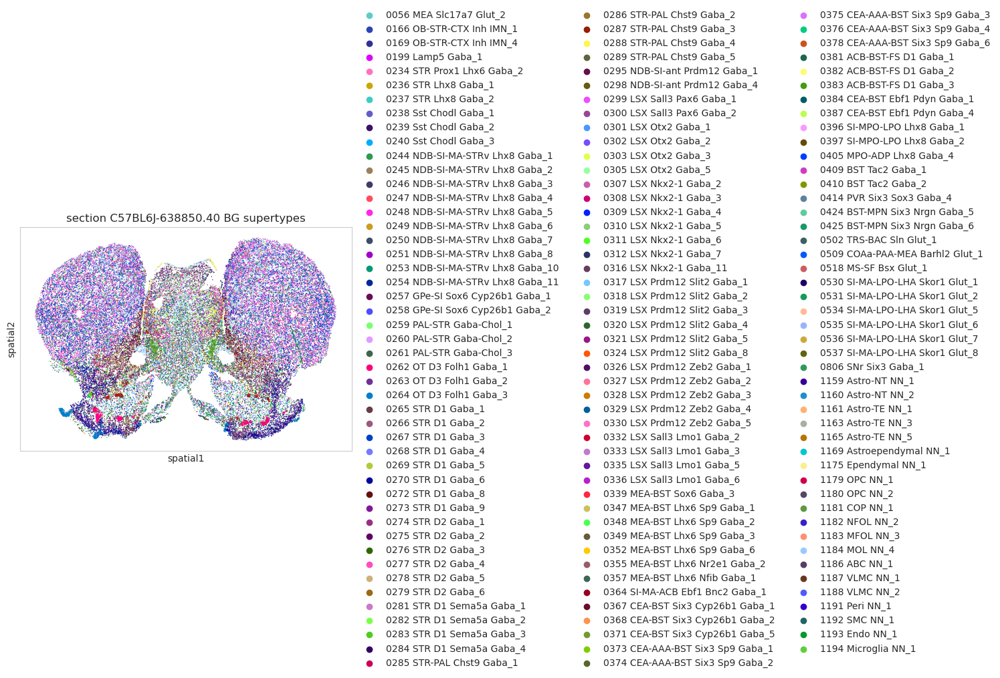

In [61]:
# plot
sc.pl.spatial(sec49_adata, color='supertype', spot_size=0.02, palette=mf_adata.uns['supertype_palette'], title=['section C57BL6J-638850.40 BG supertypes'])

In [62]:
# split 0277 STR D2 Gaba_4
np.sort(sec49_adata[sec49_adata.obs['supertype'] == '0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [63]:
len(np.sort(sec49_adata.obs['supertype'].cat.categories))

140

In [64]:
# add new category items
sec49_adata.obs['supertype'] = sec49_adata.obs['supertype'].cat.add_categories(['0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*'])
sec49_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1184 MOL NN_4', '1186 ABC NN_1', '1187 VLMC NN_1', '1188 VLMC NN_2',
       '1191 Peri NN_1', '1192 SMC NN_1', '1193 Endo NN_1',
       '1194 Microglia NN_1', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*'],
      dtype='object', length=142)

In [65]:
# reorder the category items
sec49_adata.obs['supertype'] = sec49_adata.obs['supertype'].cat.reorder_categories(np.sort(sec49_adata.obs['supertype'].cat.categories), ordered=True)
sec49_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1182 NFOL NN_2', '1183 MFOL NN_3', '1184 MOL NN_4', '1186 ABC NN_1',
       '1187 VLMC NN_1', '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype='object', length=142)

In [66]:
len(np.sort(sec49_adata.obs['supertype'].cat.categories))

142

In [67]:
sec49_adata.obs.loc[sec49_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
sec49_adata.obs.loc[sec49_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [68]:
# update color palette (according to spatial human BG color palette)
# 'STRd D1 Striosome MSN': '#00f3f7ff',
# 'STRd D1 Matrix MSN': '#3e0aaeff',
# 'STRd D2 Striosome MSN': '#06b374ff'
# 'STRd D2 Matrix MSN': '#8e0537ff',

sec49_adata.uns['supertype_palette']['0268 STR D1 Gaba_4'] = '#00f3f7ff'
sec49_adata.uns['supertype_palette']['0267 STR D1 Gaba_3'] = '#3e0aaeff'
sec49_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_A*'] = '#06b374ff'
sec49_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_B*'] = '#8e0537ff'

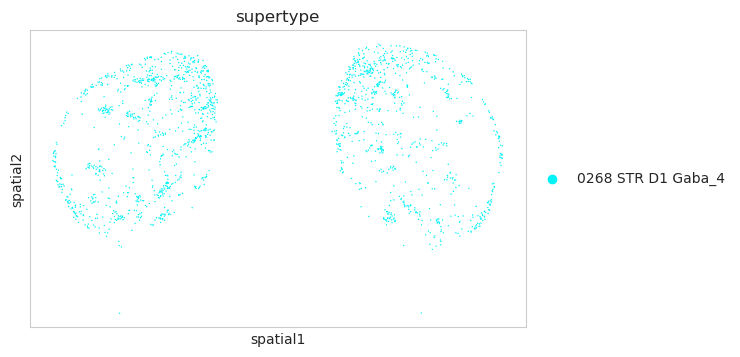

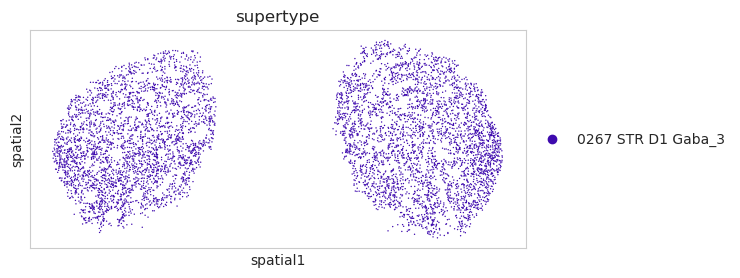

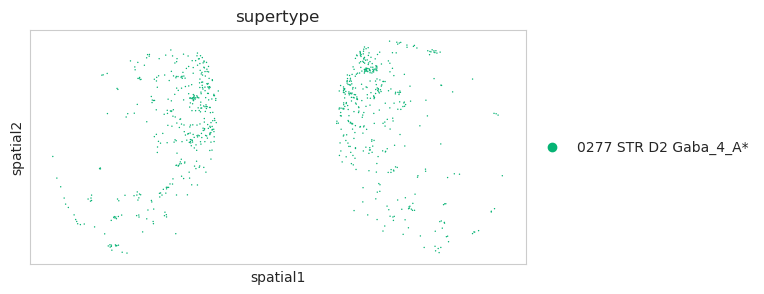

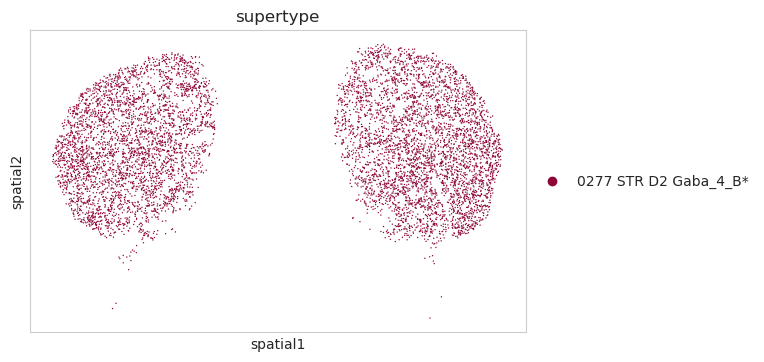

In [69]:
temp_list = ['0268 STR D1 Gaba_4', '0267 STR D1 Gaba_3', '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*']

for temp in temp_list:
    sc.pl.spatial(sec49_adata[sec49_adata.obs['supertype'] == temp], color='supertype', spot_size=0.02, palette=sec49_adata.uns['supertype_palette'])

In [70]:
# save the data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_mf_sec49_20251005.pkl'), 'wb') as f:
    pickle.dump(sec49_adata, f)

# Subset WMB MERFISH sec46 BG data

In [71]:
sec46_adata = mf_bg_adata[mf_bg_adata.obs['brain_section_label'] == 'C57BL6J-638850.46']
sec46_adata

View of AnnData object with n_obs × n_vars = 32506 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_pal

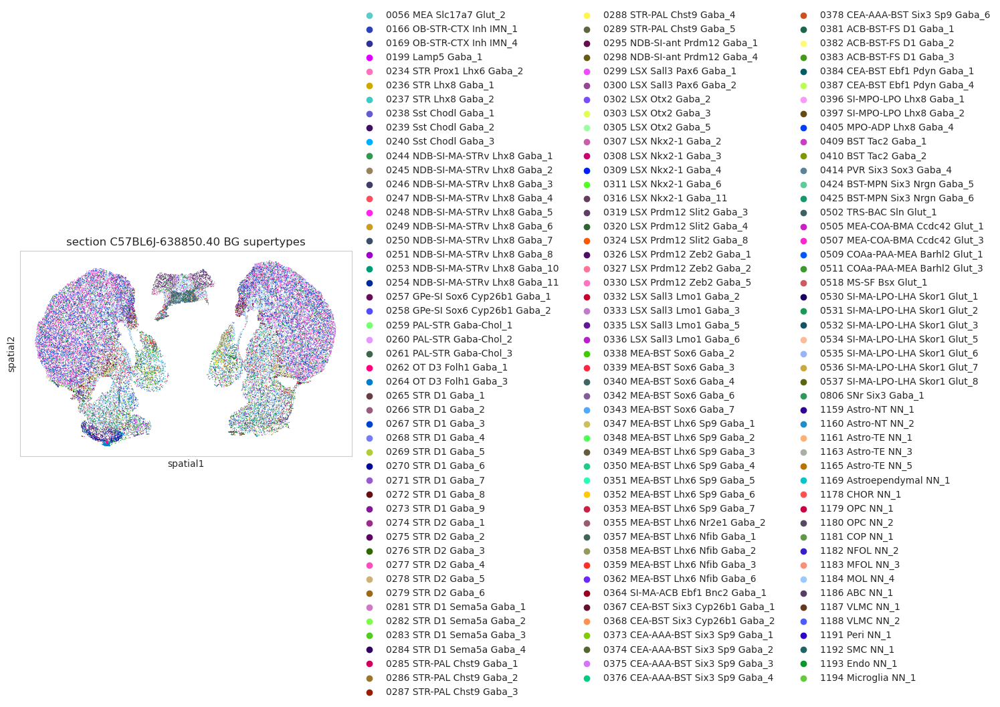

In [72]:
# plot
sc.pl.spatial(sec46_adata, color='supertype', spot_size=0.02, palette=mf_adata.uns['supertype_palette'], title=['section C57BL6J-638850.40 BG supertypes'])

In [73]:
# split 0277 STR D2 Gaba_4
np.sort(sec46_adata[sec46_adata.obs['supertype'] == '0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [74]:
len(np.sort(sec46_adata.obs['supertype'].cat.categories))

145

In [75]:
# add new category items
sec46_adata.obs['supertype'] = sec46_adata.obs['supertype'].cat.add_categories(['0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*'])
sec46_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1184 MOL NN_4', '1186 ABC NN_1', '1187 VLMC NN_1', '1188 VLMC NN_2',
       '1191 Peri NN_1', '1192 SMC NN_1', '1193 Endo NN_1',
       '1194 Microglia NN_1', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*'],
      dtype='object', length=147)

In [76]:
# reorder the category items
sec46_adata.obs['supertype'] = sec46_adata.obs['supertype'].cat.reorder_categories(np.sort(sec46_adata.obs['supertype'].cat.categories), ordered=True)
sec46_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1182 NFOL NN_2', '1183 MFOL NN_3', '1184 MOL NN_4', '1186 ABC NN_1',
       '1187 VLMC NN_1', '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype='object', length=147)

In [77]:
len(np.sort(sec46_adata.obs['supertype'].cat.categories))

147

In [78]:
sec46_adata.obs.loc[sec46_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
sec46_adata.obs.loc[sec46_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [79]:
# update color palette (according to spatial human BG color palette)
# 'STRd D1 Striosome MSN': '#00f3f7ff',
# 'STRd D1 Matrix MSN': '#3e0aaeff',
# 'STRd D2 Striosome MSN': '#06b374ff'
# 'STRd D2 Matrix MSN': '#8e0537ff',

sec46_adata.uns['supertype_palette']['0268 STR D1 Gaba_4'] = '#00f3f7ff'
sec46_adata.uns['supertype_palette']['0267 STR D1 Gaba_3'] = '#3e0aaeff'
sec46_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_A*'] = '#06b374ff'
sec46_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_B*'] = '#8e0537ff'

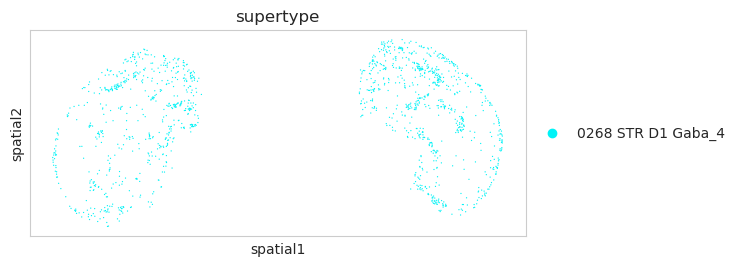

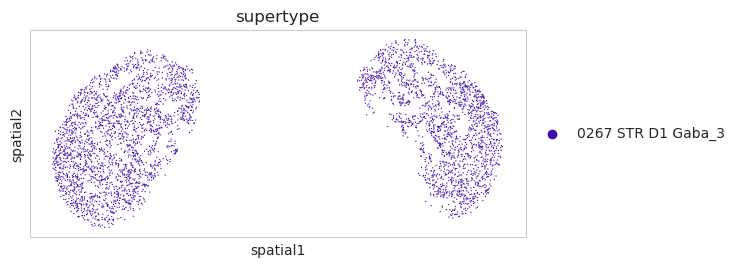

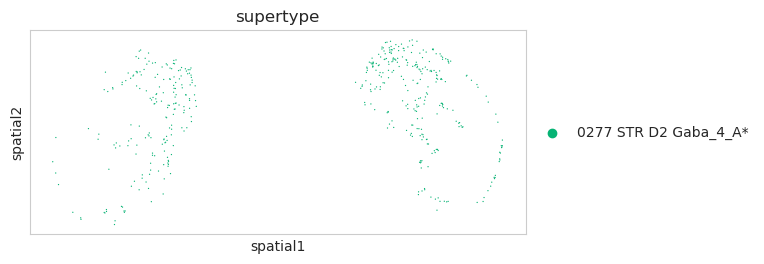

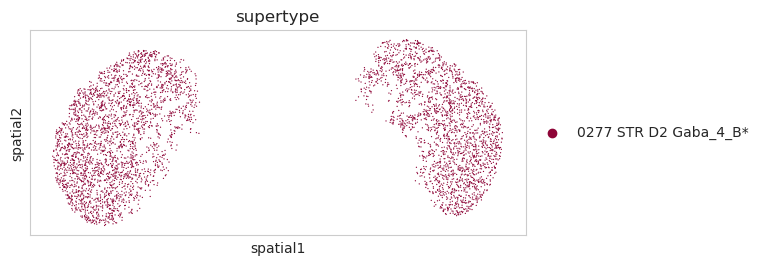

In [80]:
temp_list = ['0268 STR D1 Gaba_4', '0267 STR D1 Gaba_3', '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*']

for temp in temp_list:
    sc.pl.spatial(sec46_adata[sec46_adata.obs['supertype'] == temp], color='supertype', spot_size=0.02, palette=sec46_adata.uns['supertype_palette'])

In [81]:
# save the data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_mf_sec46_20251005.pkl'), 'wb') as f:
    pickle.dump(sec46_adata, f)

# Load imputed WMB MERFISH data

In [7]:
# load imputed merfish data
file_path = abc_cache.get_data_path(directory='MERFISH-C57BL6J-638850-imputed', file_name='C57BL6J-638850-imputed/log2')
# file_path = abc_cache.get_data_path(directory='MERFISH-C57BL6J-638850', file_name='C57BL6J-638850/log2')
imp_mf_adata = sc.read_h5ad(file_path)
imp_mf_adata

AnnData object with n_obs × n_vars = 4334174 × 8460
    obs: 'brain_section_label'
    var: 'gene_symbol'

In [8]:
# cell meta data (ccf registered)
cell_meta = abc_cache.get_metadata_dataframe(
    directory='MERFISH-C57BL6J-638850-CCF',
    file_name='cell_metadata_with_parcellation_annotation',
    index_col='cell_label',
    dtype={'cell_label': str}
)
print(len(cell_meta))
cell_meta

3739961


,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_organ,parcellation_category,parcellation_division,parcellation_structure,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color
cell_label,,,,,,,,,,,,,,,,,,,,,
1019171907102340387-1,C57BL6J-638850.37,1408,0.596276,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.226245,4.148963,6.6,...,brain,grey,HPF,DG,DG-po,#FFFFFF,#BFDAE3,#7ED04B,#7ED04B,#7ED04B
1104095349101460194-1,C57BL6J-638850.26,4218,0.641180,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.064889,7.309543,4.2,...,brain,grey,P,TRN,TRN,#FFFFFF,#BFDAE3,#FF9B88,#FFBA86,#FFBA86
1017092617101450577,C57BL6J-638850.25,4218,0.763531,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.792921,8.189973,4.0,...,brain,grey,P,P-unassigned,P-unassigned,#FFFFFF,#BFDAE3,#FF9B88,#FF9B88,#FF9B88
1018093344101130233,C57BL6J-638850.13,4218,0.558073,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.195950,5.868655,2.4,...,brain,fiber tracts,cbf,arb,arb,#FFFFFF,#CCCCCC,#CCCCCC,#CCCCCC,#CCCCCC
1019171912201610094,C57BL6J-638850.27,4218,0.591009,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.635732,7.995842,4.4,...,brain,grey,P,P-unassigned,P-unassigned,#FFFFFF,#BFDAE3,#FF9B88,#FF9B88,#FF9B88
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018093344100380167-3,C57BL6J-638850.47,5252,0.574988,C57BL6J-638850,C57BL6J-638850,wt/wt,M,1.560003,4.669243,8.8,...,brain,grey,Isocortex,SSp-n,SSp-n2/3,#FFFFFF,#BFDAE3,#70FF71,#188064,#188064
1017165415100930567,C57BL6J-638850.57,5254,0.620546,C57BL6J-638850,C57BL6J-638850,wt/wt,M,5.032556,3.695696,11.0,...,brain,grey,Isocortex,ACAd,ACAd5,#FFFFFF,#BFDAE3,#70FF71,#40A666,#40A666
1017155956102610748,C57BL6J-638850.49,5254,0.548053,C57BL6J-638850,C57BL6J-638850,wt/wt,M,2.549142,4.231188,9.2,...,brain,grey,Isocortex,SSp-m,SSp-m6a,#FFFFFF,#BFDAE3,#70FF71,#188064,#188064


In [9]:
# get intersected indexes
valid_index = imp_mf_adata.obs.index.intersection(cell_meta.index)
imp_mf_adata = imp_mf_adata[valid_index].copy()
imp_mf_adata

AnnData object with n_obs × n_vars = 3739961 × 8460
    obs: 'brain_section_label'
    var: 'gene_symbol'

In [10]:
# add cell meta to adata (reoder the adata indexes)
imp_mf_adata.obs = cell_meta.loc[imp_mf_adata.obs.index].copy()
imp_mf_adata

AnnData object with n_obs × n_vars = 3739961 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'

In [11]:
# add coordinates to obsm.spatial
imp_mf_adata.obsm['spatial'] = imp_mf_adata.obs[['x_section', 'y_section', 'z_section']].copy().to_numpy()
imp_mf_adata

AnnData object with n_obs × n_vars = 3739961 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    obsm: 'spatial'

In [12]:
from utils import set_color_palettes
set_color_palettes(imp_mf_adata, do_parcellation=True)
imp_mf_adata

AnnData object with n_obs × n_vars = 3739961 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellatio

In [13]:
# subset to BG cell types
imp_mf_adata = imp_mf_adata[imp_mf_adata.obs['parcellation_division'].isin(['STR', 'PAL'])].copy()
imp_mf_adata

AnnData object with n_obs × n_vars = 479231 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation

In [14]:
# subset section 50
imp_sec50_adata = imp_mf_adata[imp_mf_adata.obs['brain_section_label'] == 'C57BL6J-638850.50'].copy()
imp_sec50_adata

AnnData object with n_obs × n_vars = 45611 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [15]:
# subset section 49
imp_sec49_adata = imp_mf_adata[imp_mf_adata.obs['brain_section_label'] == 'C57BL6J-638850.49'].copy()
imp_sec49_adata

AnnData object with n_obs × n_vars = 52130 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [16]:
# subset section 46
imp_sec46_adata = imp_mf_adata[imp_mf_adata.obs['brain_section_label'] == 'C57BL6J-638850.46'].copy()
imp_sec46_adata

AnnData object with n_obs × n_vars = 33871 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [17]:
# save the results
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_imp_mf_sec50_20251005.pkl'), 'wb') as f:
    pickle.dump(imp_sec50_adata, f)

with open(join(save_dir, 'WMB_imp_mf_sec49_20251005.pkl'), 'wb') as f:
    pickle.dump(imp_sec49_adata, f)

with open(join(save_dir, 'WMB_imp_mf_sec46_20251005.pkl'), 'wb') as f:
    pickle.dump(imp_sec46_adata, f)

# Subset imputed WMB MERFISH sec50 BG data

In [19]:
# load filter cell types
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_cell_types_20251005.pkl'), 'rb') as f:
    filter_ctypes = pickle.load(f)

In [20]:
len(filter_ctypes)

163

In [21]:
# load sec50
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_imp_mf_sec50_20251004.pkl'), 'rb') as f:
    imp_sec50_adata = pickle.load(f)
imp_sec50_adata

AnnData object with n_obs × n_vars = 45611 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [22]:
# subset to filter cell types
imp_sec50_adata = imp_sec50_adata[imp_sec50_adata.obs['supertype'].isin(filter_ctypes)].copy()
imp_sec50_adata

AnnData object with n_obs × n_vars = 44848 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

/tmp/ipykernel_1069713/3127993750.py:2: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(imp_sec50_adata, color='supertype', spot_size=0.02, palette=imp_sec50_adata.uns['supertype_palette'], title=['section C57BL6J-638850.50 BG supertypes'])


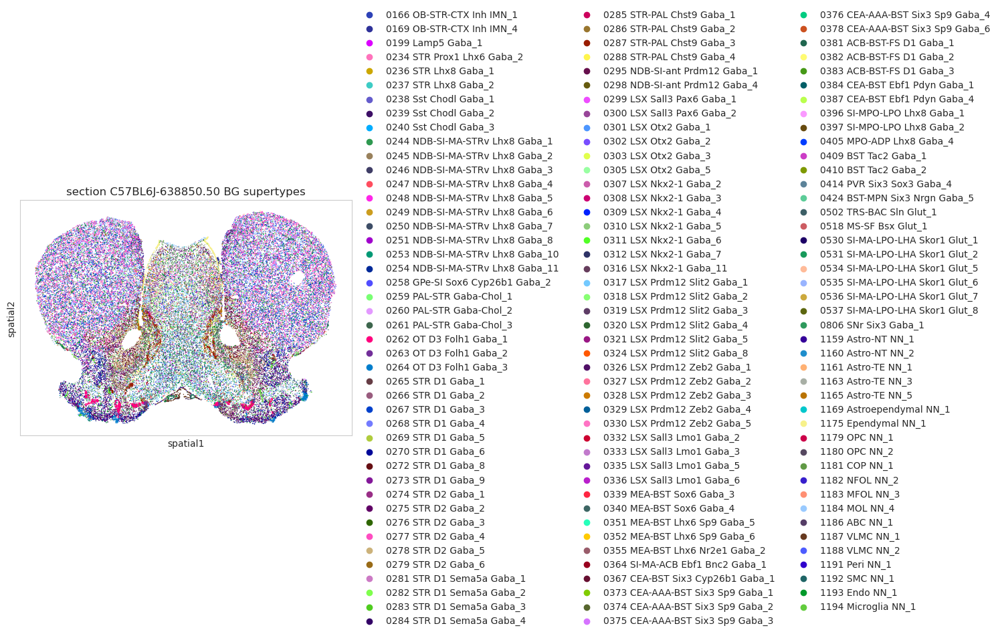

In [23]:
# plot
sc.pl.spatial(imp_sec50_adata, color='supertype', spot_size=0.02, palette=imp_sec50_adata.uns['supertype_palette'], title=['section C57BL6J-638850.50 BG supertypes'])

In [24]:
# split 0277 STR D2 Gaba_4
np.sort(imp_sec50_adata[imp_sec50_adata.obs['supertype']=='0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [25]:
len(np.sort(imp_sec50_adata.obs['supertype'].cat.categories))

131

In [26]:
# add new category items
imp_sec50_adata.obs['supertype'] = imp_sec50_adata.obs['supertype'].cat.add_categories(['0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*'])
imp_sec50_adata.obs['supertype'].cat.categories

Index(['0166 OB-STR-CTX Inh IMN_1', '0169 OB-STR-CTX Inh IMN_4',
       '0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
       '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       '0244 NDB-SI-MA-STRv Lhx8 Gaba_1',
       ...
       '1184 MOL NN_4', '1186 ABC NN_1', '1187 VLMC NN_1', '1188 VLMC NN_2',
       '1191 Peri NN_1', '1192 SMC NN_1', '1193 Endo NN_1',
       '1194 Microglia NN_1', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*'],
      dtype='object', length=133)

In [27]:
# reorder the category items
imp_sec50_adata.obs['supertype'] = imp_sec50_adata.obs['supertype'].cat.reorder_categories(np.sort(imp_sec50_adata.obs['supertype'].cat.categories), ordered=True)
imp_sec50_adata.obs['supertype'].cat.categories

Index(['0166 OB-STR-CTX Inh IMN_1', '0169 OB-STR-CTX Inh IMN_4',
       '0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
       '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       '0244 NDB-SI-MA-STRv Lhx8 Gaba_1',
       ...
       '1182 NFOL NN_2', '1183 MFOL NN_3', '1184 MOL NN_4', '1186 ABC NN_1',
       '1187 VLMC NN_1', '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype='object', length=133)

In [28]:
len(np.sort(imp_sec50_adata.obs['supertype'].cat.categories))

133

In [29]:
imp_sec50_adata.obs.loc[imp_sec50_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
imp_sec50_adata.obs.loc[imp_sec50_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [30]:
# update color palette
# according to spatial human BG color palette, others using wmb's palette

# 'STRd D1 Striosome MSN': '#00f3f7ff',
# 'STRd D1 Matrix MSN': '#3e0aaeff',
# 'STRd D2 Striosome MSN': '#06b374ff'
# 'STRd D2 Matrix MSN': '#8e0537ff',

imp_sec50_adata.uns['supertype_palette']['0268 STR D1 Gaba_4'] = '#00f3f7ff'
imp_sec50_adata.uns['supertype_palette']['0267 STR D1 Gaba_3'] = '#3e0aaeff'
imp_sec50_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_A*'] = '#06b374ff'
imp_sec50_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_B*'] = '#8e0537ff'

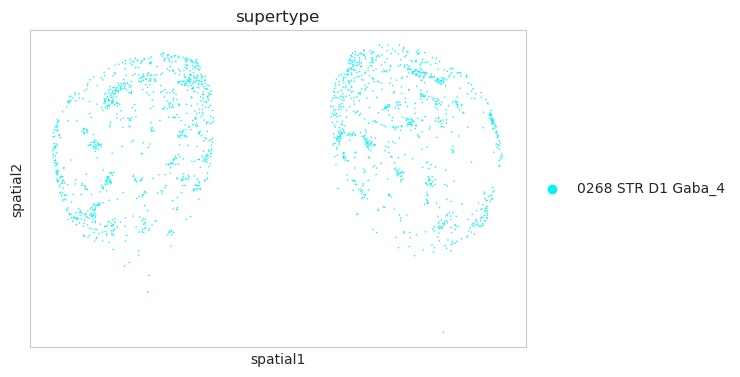

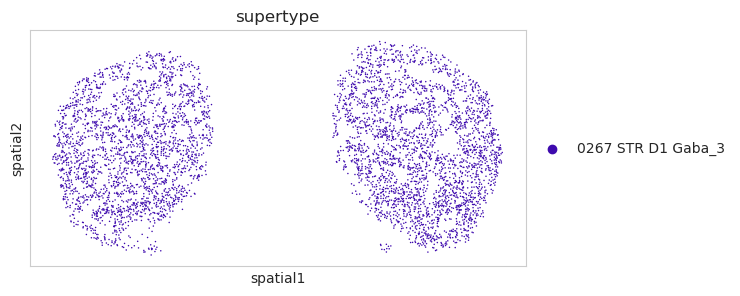

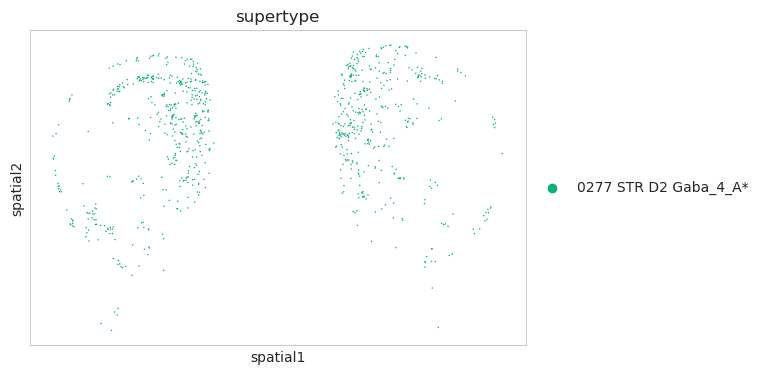

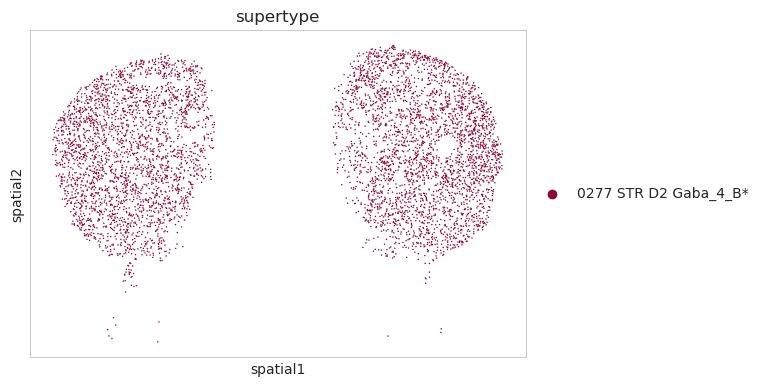

In [31]:
warnings.filterwarnings('ignore')

temp_list = ['0268 STR D1 Gaba_4', '0267 STR D1 Gaba_3', '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*']

for temp in temp_list:
    sc.pl.spatial(imp_sec50_adata[imp_sec50_adata.obs['supertype']==temp], color='supertype', spot_size=0.02, palette=imp_sec50_adata.uns['supertype_palette'])

In [32]:
# unimputed merfish data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_mf_sec50_20251005.pkl'), 'rb') as f:
    sec50_adata = pickle.load(f)
sec50_adata

AnnData object with n_obs × n_vars = 44848 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', '

In [33]:
imp_sec50_adata

AnnData object with n_obs × n_vars = 44848 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [34]:
# unify the cell order betwen imputed & unimputed merfish (for computational stability)
imp_sec50_adata = imp_sec50_adata[sec50_adata.obs.index].copy()
imp_sec50_adata

AnnData object with n_obs × n_vars = 44848 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [35]:
# save the data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_imp_mf_sec50_20251005.pkl'), 'wb') as f:
    pickle.dump(imp_sec50_adata, f)

# Subset imputed WMB MERFISH sec49 BG data

In [36]:
# load sec49
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_imp_mf_sec49_20251005.pkl'), 'rb') as f:
    imp_sec49_adata = pickle.load(f)
imp_sec49_adata

AnnData object with n_obs × n_vars = 52130 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [37]:
# subset to filter cell types
imp_sec49_adata = imp_sec49_adata[imp_sec49_adata.obs['supertype'].isin(filter_ctypes)].copy()
imp_sec49_adata

AnnData object with n_obs × n_vars = 50986 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

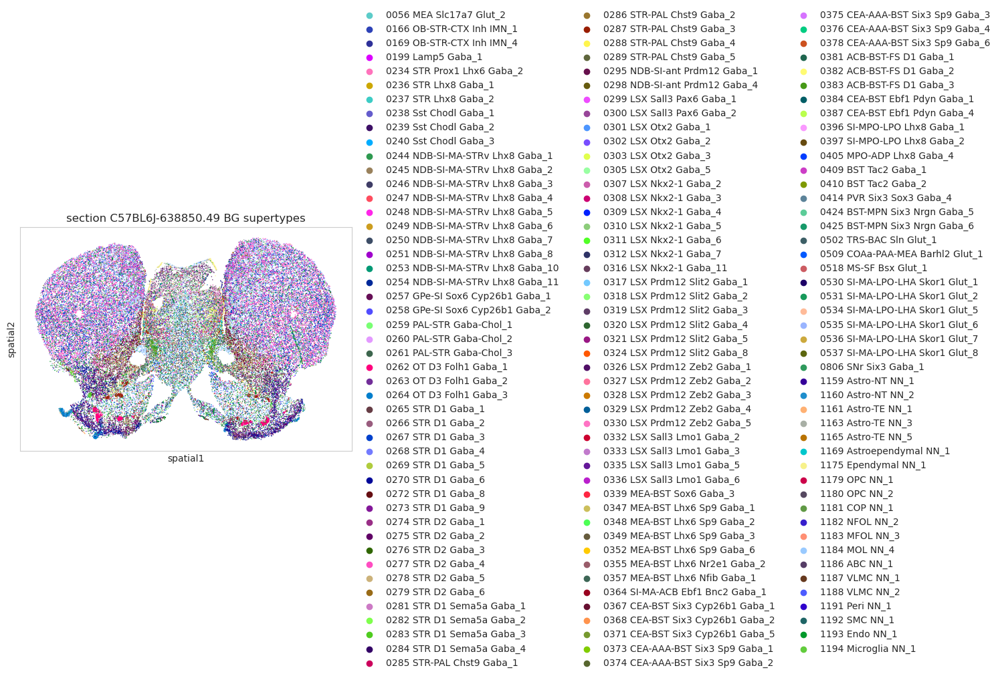

In [38]:
warnings.filterwarnings('ignore')

# plot
sc.pl.spatial(imp_sec49_adata, color='supertype', spot_size=0.02, palette=imp_sec49_adata.uns['supertype_palette'], title=['section C57BL6J-638850.49 BG supertypes'])

In [39]:
# split 0277 STR D2 Gaba_4
np.sort(imp_sec49_adata[imp_sec49_adata.obs['supertype']=='0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [40]:
len(np.sort(imp_sec49_adata.obs['supertype'].cat.categories))

140

In [41]:
# add new category items
imp_sec49_adata.obs['supertype'] = imp_sec49_adata.obs['supertype'].cat.add_categories(['0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*'])
imp_sec49_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1184 MOL NN_4', '1186 ABC NN_1', '1187 VLMC NN_1', '1188 VLMC NN_2',
       '1191 Peri NN_1', '1192 SMC NN_1', '1193 Endo NN_1',
       '1194 Microglia NN_1', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*'],
      dtype='object', length=142)

In [42]:
# reorder the category items
imp_sec49_adata.obs['supertype'] = imp_sec49_adata.obs['supertype'].cat.reorder_categories(np.sort(imp_sec49_adata.obs['supertype'].cat.categories), ordered=True)
imp_sec49_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1182 NFOL NN_2', '1183 MFOL NN_3', '1184 MOL NN_4', '1186 ABC NN_1',
       '1187 VLMC NN_1', '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype='object', length=142)

In [43]:
len(np.sort(imp_sec49_adata.obs['supertype'].cat.categories))

142

In [44]:
imp_sec49_adata.obs.loc[imp_sec49_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
imp_sec49_adata.obs.loc[imp_sec49_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [45]:
# update color palette
# according to spatial human BG color palette, others using wmb's palette

# 'STRd D1 Striosome MSN': '#00f3f7ff',
# 'STRd D1 Matrix MSN': '#3e0aaeff',
# 'STRd D2 Striosome MSN': '#06b374ff'
# 'STRd D2 Matrix MSN': '#8e0537ff',

imp_sec49_adata.uns['supertype_palette']['0268 STR D1 Gaba_4'] = '#00f3f7ff'
imp_sec49_adata.uns['supertype_palette']['0267 STR D1 Gaba_3'] = '#3e0aaeff'
imp_sec49_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_A*'] = '#06b374ff'
imp_sec49_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_B*'] = '#8e0537ff'

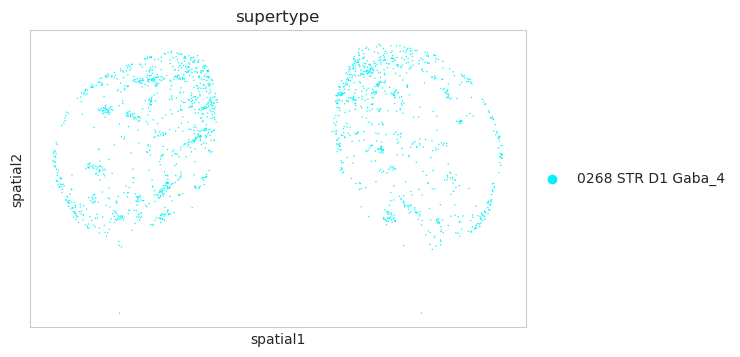

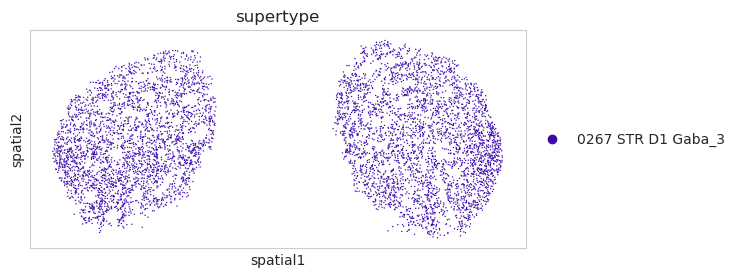

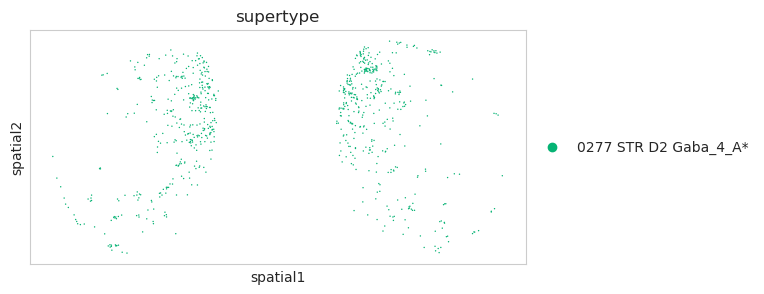

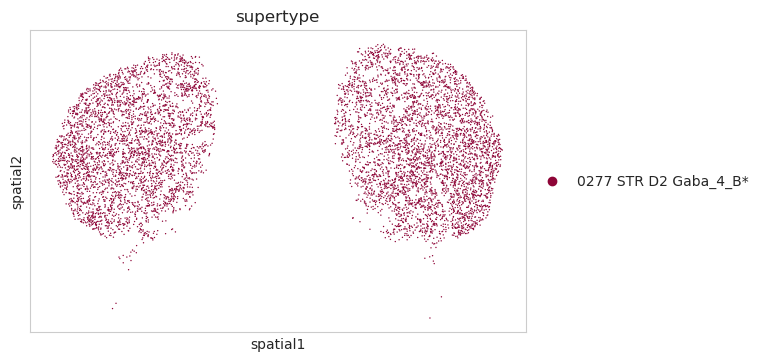

In [46]:
warnings.filterwarnings('ignore')

temp_list = ['0268 STR D1 Gaba_4', '0267 STR D1 Gaba_3', '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*']

for temp in temp_list:
    sc.pl.spatial(imp_sec49_adata[imp_sec49_adata.obs['supertype']==temp], color='supertype', spot_size=0.02, palette=imp_sec49_adata.uns['supertype_palette'])

In [47]:
# unimputed merfish data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_mf_sec49_20251005.pkl'), 'rb') as f:
    sec49_adata = pickle.load(f)
sec49_adata

AnnData object with n_obs × n_vars = 50986 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', '

In [48]:
imp_sec49_adata

AnnData object with n_obs × n_vars = 50986 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [49]:
# unify the cell order betwen imputed & unimputed merfish (for computational stability)
imp_sec49_adata = imp_sec49_adata[sec49_adata.obs.index].copy()
imp_sec49_adata

AnnData object with n_obs × n_vars = 50986 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [50]:
# save the data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_imp_mf_sec49_20251005.pkl'), 'wb') as f:
    pickle.dump(imp_sec49_adata, f)

# Subset imputed WMB MERFISH sec46 BG data

In [51]:
# load sec46
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_imp_mf_sec46_20251005.pkl'), 'rb') as f:
    imp_sec46_adata = pickle.load(f)
imp_sec46_adata

AnnData object with n_obs × n_vars = 33871 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [52]:
# subset to filter cell types
imp_sec46_adata = imp_sec46_adata[imp_sec46_adata.obs['supertype'].isin(filter_ctypes)].copy()
imp_sec46_adata

AnnData object with n_obs × n_vars = 32506 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

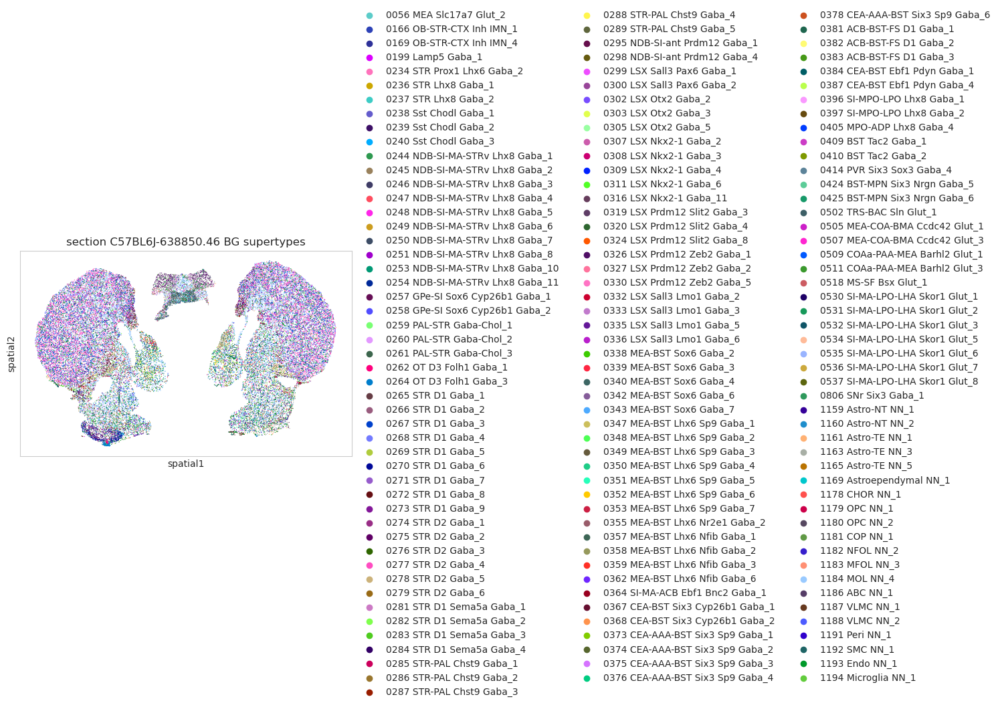

In [53]:
warnings.filterwarnings('ignore')

# plot
sc.pl.spatial(imp_sec46_adata, color='supertype', spot_size=0.02, palette=imp_sec46_adata.uns['supertype_palette'], title=['section C57BL6J-638850.46 BG supertypes'])

In [54]:
# split 0277 STR D2 Gaba_4
np.sort(imp_sec46_adata[imp_sec46_adata.obs['supertype']=='0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [55]:
len(np.sort(imp_sec46_adata.obs['supertype'].cat.categories))

145

In [56]:
# add new category items
imp_sec46_adata.obs['supertype'] = imp_sec46_adata.obs['supertype'].cat.add_categories(['0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*'])
imp_sec46_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1184 MOL NN_4', '1186 ABC NN_1', '1187 VLMC NN_1', '1188 VLMC NN_2',
       '1191 Peri NN_1', '1192 SMC NN_1', '1193 Endo NN_1',
       '1194 Microglia NN_1', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*'],
      dtype='object', length=147)

In [57]:
# reorder the category items
imp_sec46_adata.obs['supertype'] = imp_sec46_adata.obs['supertype'].cat.reorder_categories(np.sort(imp_sec46_adata.obs['supertype'].cat.categories), ordered=True)
imp_sec46_adata.obs['supertype'].cat.categories

Index(['0056 MEA Slc17a7 Glut_2', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       ...
       '1182 NFOL NN_2', '1183 MFOL NN_3', '1184 MOL NN_4', '1186 ABC NN_1',
       '1187 VLMC NN_1', '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype='object', length=147)

In [58]:
len(np.sort(imp_sec46_adata.obs['supertype'].cat.categories))

147

In [59]:
imp_sec46_adata.obs.loc[imp_sec46_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
imp_sec46_adata.obs.loc[imp_sec46_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [60]:
# update color palette
# according to spatial human BG color palette, others using wmb's palette

# 'STRd D1 Striosome MSN': '#00f3f7ff',
# 'STRd D1 Matrix MSN': '#3e0aaeff',
# 'STRd D2 Striosome MSN': '#06b374ff'
# 'STRd D2 Matrix MSN': '#8e0537ff',

imp_sec46_adata.uns['supertype_palette']['0268 STR D1 Gaba_4'] = '#00f3f7ff'
imp_sec46_adata.uns['supertype_palette']['0267 STR D1 Gaba_3'] = '#3e0aaeff'
imp_sec46_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_A*'] = '#06b374ff'
imp_sec46_adata.uns['supertype_palette']['0277 STR D2 Gaba_4_B*'] = '#8e0537ff'

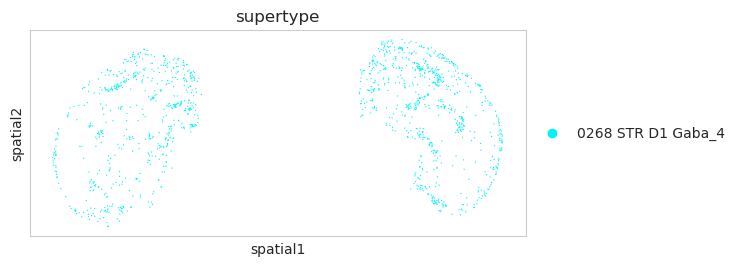

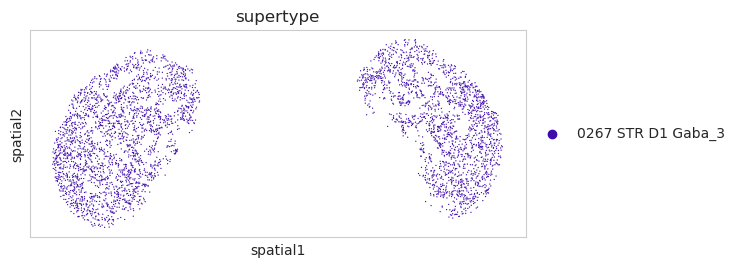

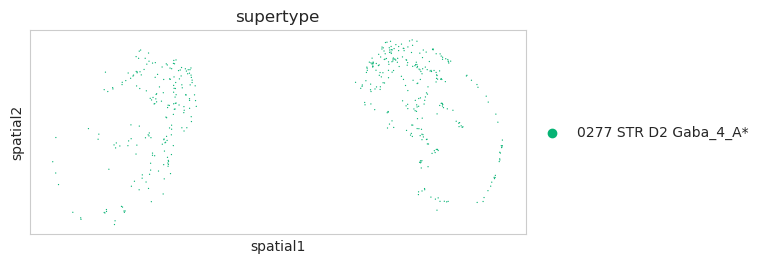

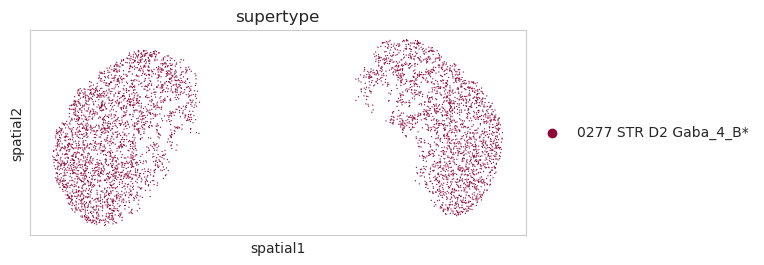

In [61]:
warnings.filterwarnings('ignore')

temp_list = ['0268 STR D1 Gaba_4', '0267 STR D1 Gaba_3', '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*']

for temp in temp_list:
    sc.pl.spatial(imp_sec46_adata[imp_sec46_adata.obs['supertype']==temp], color='supertype', spot_size=0.02, palette=imp_sec46_adata.uns['supertype_palette'])

In [62]:
# unimputed merfish data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_mf_sec46_20251005.pkl'), 'rb') as f:
    sec46_adata = pickle.load(f)
sec46_adata

AnnData object with n_obs × n_vars = 32506 × 550
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol', 'transcript_identifier'
    uns: 'accessed_on', 'src', 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', '

In [63]:
imp_sec46_adata

AnnData object with n_obs × n_vars = 32506 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [64]:
# unify the cell order betwen imputed & unimputed merfish (for computational stability)
imp_sec46_adata = imp_sec46_adata[sec46_adata.obs.index].copy()
imp_sec46_adata

AnnData object with n_obs × n_vars = 32506 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'parcellation_

In [65]:
# save the data
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_imp_mf_sec46_20251005.pkl'), 'wb') as f:
    pickle.dump(imp_sec46_adata, f)

# Subset WMB scRNA-seq BG data

In [83]:
abc_cache.list_directories

['ASAP-PMDBS-10X',
 'ASAP-PMDBS-taxonomy',
 'Allen-CCF-2020',
 'HMBA-10xMultiome-BG',
 'HMBA-10xMultiome-BG-Aligned',
 'HMBA-BG-taxonomy-CCN20250428',
 'MERFISH-C57BL6J-638850',
 'MERFISH-C57BL6J-638850-CCF',
 'MERFISH-C57BL6J-638850-imputed',
 'MERFISH-C57BL6J-638850-sections',
 'SEAAD',
 'SEAAD-taxonomy',
 'WHB-10Xv3',
 'WHB-taxonomy',
 'WMB-10X',
 'WMB-10XMulti',
 'WMB-10Xv2',
 'WMB-10Xv3',
 'WMB-neighborhoods',
 'WMB-taxonomy',
 'Zeng-Aging-Mouse-10Xv3',
 'Zeng-Aging-Mouse-WMB-taxonomy',
 'Zhuang-ABCA-1',
 'Zhuang-ABCA-1-CCF',
 'Zhuang-ABCA-2',
 'Zhuang-ABCA-2-CCF',
 'Zhuang-ABCA-3',
 'Zhuang-ABCA-3-CCF',
 'Zhuang-ABCA-4',
 'Zhuang-ABCA-4-CCF']

In [84]:
abc_cache.list_data_files('WMB-10Xv3')

['WMB-10Xv3-CB/log2',
 'WMB-10Xv3-CB/raw',
 'WMB-10Xv3-CTXsp/log2',
 'WMB-10Xv3-CTXsp/raw',
 'WMB-10Xv3-HPF/log2',
 'WMB-10Xv3-HPF/raw',
 'WMB-10Xv3-HY/log2',
 'WMB-10Xv3-HY/raw',
 'WMB-10Xv3-Isocortex-1/log2',
 'WMB-10Xv3-Isocortex-1/raw',
 'WMB-10Xv3-Isocortex-2/log2',
 'WMB-10Xv3-Isocortex-2/raw',
 'WMB-10Xv3-MB/log2',
 'WMB-10Xv3-MB/raw',
 'WMB-10Xv3-MY/log2',
 'WMB-10Xv3-MY/raw',
 'WMB-10Xv3-OLF/log2',
 'WMB-10Xv3-OLF/raw',
 'WMB-10Xv3-P/log2',
 'WMB-10Xv3-P/raw',
 'WMB-10Xv3-PAL/log2',
 'WMB-10Xv3-PAL/raw',
 'WMB-10Xv3-STR/log2',
 'WMB-10Xv3-STR/raw',
 'WMB-10Xv3-TH/log2',
 'WMB-10Xv3-TH/raw']

In [85]:
# Load WMB scRNA-seq STR data
sc_str_path = abc_cache.get_data_path(directory='WMB-10Xv3', file_name='WMB-10Xv3-STR/log2')
sc_str_adata = sc.read_h5ad(sc_str_path)
sc_str_adata

AnnData object with n_obs × n_vars = 285167 × 32285
    obs: 'cell_barcode', 'library_label', 'anatomical_division_label'
    var: 'gene_symbol'
    uns: 'normalization', 'parent', 'parent_layer', 'parent_rows'

In [86]:
# Load WMB scRNA-seq PAL data
sc_pal_path = abc_cache.get_data_path(directory='WMB-10Xv3', file_name='WMB-10Xv3-PAL/log2')
sc_pal_adata = sc.read_h5ad(sc_pal_path)
sc_pal_adata

AnnData object with n_obs × n_vars = 108677 × 32285
    obs: 'cell_barcode', 'library_label', 'anatomical_division_label'
    var: 'gene_symbol'
    uns: 'normalization', 'parent', 'parent_layer', 'parent_rows'

In [87]:
sc_adata = anndata.concat([sc_str_adata, sc_pal_adata],
                          axis=0, join='inner', merge='first')
sc_adata

AnnData object with n_obs × n_vars = 393844 × 32285
    obs: 'cell_barcode', 'library_label', 'anatomical_division_label'
    var: 'gene_symbol'

In [88]:
sc_adata.X[10:100, 10:100].data

array([7.4051337, 6.4136205, 7.4051337, ..., 5.8055496, 6.792594 ,
       5.8055496], dtype=float32)

In [89]:
# load cell meta info
cell_meta = abc_cache.get_metadata_dataframe(
    directory='WMB-10X',
    file_name='cell_metadata_with_cluster_annotation',
    index_col='cell_label',
    dtype={'cell_label': str, 'neurotransmitter': str}
)
print(len(cell_meta))
cell_meta

4042976


,cell_barcode,barcoded_cell_sample_label,library_label,feature_matrix_label,entity,brain_section_label,library_method,region_of_interest_acronym,donor_label,donor_genotype,...,subclass,supertype,cluster,neurotransmitter_color,class_color,subclass_color,supertype_color,cluster_color,region_of_interest_order,region_of_interest_color
cell_label,,,,,,,,,,,,,,,,,,,,,
GCGAGAAGTTAAGGGC-410_B05,GCGAGAAGTTAAGGGC,410_B05,L8TX_201030_01_C12,WMB-10Xv3-HPF,cell,NaN,10Xv3,RHP,Snap25-IRES2-Cre;Ai14-550850,Ai14(RCL-tdT)/wt,...,018 L2 IT PPP-APr Glut,0082 L2 IT PPP-APr Glut_3,0326 L2 IT PPP-APr Glut_3,#2B93DF,#FA0087,#0F6632,#266DFF,#64661F,15,#CCB05C
AATGGCTCAGCTCCTT-411_B06,AATGGCTCAGCTCCTT,411_B06,L8TX_201029_01_E10,WMB-10Xv3-HPF,cell,NaN,10Xv3,RHP,Snap25-IRES2-Cre;Ai14-550851,Ai14(RCL-tdT)/wt,...,018 L2 IT PPP-APr Glut,0082 L2 IT PPP-APr Glut_3,0326 L2 IT PPP-APr Glut_3,#2B93DF,#FA0087,#0F6632,#266DFF,#64661F,15,#CCB05C
AACACACGTTGCTTGA-410_B05,AACACACGTTGCTTGA,410_B05,L8TX_201030_01_C12,WMB-10Xv3-HPF,cell,NaN,10Xv3,RHP,Snap25-IRES2-Cre;Ai14-550850,Ai14(RCL-tdT)/wt,...,018 L2 IT PPP-APr Glut,0082 L2 IT PPP-APr Glut_3,0326 L2 IT PPP-APr Glut_3,#2B93DF,#FA0087,#0F6632,#266DFF,#64661F,15,#CCB05C
CACAGATAGAGGCGGA-410_A05,CACAGATAGAGGCGGA,410_A05,L8TX_201029_01_A10,WMB-10Xv3-HPF,cell,NaN,10Xv3,RHP,Snap25-IRES2-Cre;Ai14-550850,Ai14(RCL-tdT)/wt,...,018 L2 IT PPP-APr Glut,0082 L2 IT PPP-APr Glut_3,0326 L2 IT PPP-APr Glut_3,#2B93DF,#FA0087,#0F6632,#266DFF,#64661F,15,#CCB05C
AAAGTGAAGCATTTCG-410_B05,AAAGTGAAGCATTTCG,410_B05,L8TX_201030_01_C12,WMB-10Xv3-HPF,cell,NaN,10Xv3,RHP,Snap25-IRES2-Cre;Ai14-550850,Ai14(RCL-tdT)/wt,...,018 L2 IT PPP-APr Glut,0082 L2 IT PPP-APr Glut_3,0326 L2 IT PPP-APr Glut_3,#2B93DF,#FA0087,#0F6632,#266DFF,#64661F,15,#CCB05C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTGTGAGCAAACGCGA-1350_C05,GTGTGAGCAAACGCGA,1350_C05,L8XR_220728_01_A05,WMB-10XMulti,cell,NaN,10xRSeq_Mult,MB,C57BL6J-641405,wt/wt,...,278 NLL Gata3 Gly-Gaba,1074 NLL Gata3 Gly-Gaba_1,4804 NLL Gata3 Gly-Gaba_1,#820e57,#72195a,#E57300,#a4fcb2,#C7CC7A,25,#CC5CB0
TTAGCAATCCCTGTTA-1350_C05,TTAGCAATCCCTGTTA,1350_C05,L8XR_220728_01_A05,WMB-10XMulti,cell,NaN,10xRSeq_Mult,MB,C57BL6J-641405,wt/wt,...,157 RN Spp1 Glut,0682 RN Spp1 Glut_1,2761 RN Spp1 Glut_1,#2B93DF,#007200,#FF514D,#BA1FCC,#3DCC44,25,#CC5CB0
TTTGGCTGTCGCGCAA-1350_C05,TTTGGCTGTCGCGCAA,1350_C05,L8XR_220728_01_A05,WMB-10XMulti,cell,NaN,10xRSeq_Mult,MB,C57BL6J-641405,wt/wt,...,278 NLL Gata3 Gly-Gaba,1076 NLL Gata3 Gly-Gaba_3,4806 NLL Gata3 Gly-Gaba_3,#820e57,#72195a,#E57300,#76CC00,#FF00CA,25,#CC5CB0


In [90]:
cell_meta['region_of_interest_acronym'].unique()

array(['RHP', 'RSP', 'ACA', 'PL-ILA-ORB', 'AUD-TEa-PERI-ECT',
       'SS-GU-VISC', 'MO-FRP', 'PAL', 'sAMY', 'CTXsp', 'HY', 'STRv',
       'OLF', 'LSX', 'AI', 'STRd', 'VIS-PTLp', 'VIS', 'TH', 'MOp', 'ENT',
       'HIP', 'P', 'MB', 'MY', 'CB', 'AUD', 'SSp', 'TEa-PERI-ECT'],
      dtype=object)

In [91]:
# get intersectted indexes
valid_index = sc_adata.obs.index.intersection(cell_meta.index)
sc_adata = sc_adata[valid_index].copy()
sc_adata

AnnData object with n_obs × n_vars = 391828 × 32285
    obs: 'cell_barcode', 'library_label', 'anatomical_division_label'
    var: 'gene_symbol'

In [92]:
cell_meta = cell_meta.loc[sc_adata.obs.index].copy()
print(len(cell_meta))
cell_meta

391828


,cell_barcode,barcoded_cell_sample_label,library_label,feature_matrix_label,entity,brain_section_label,library_method,region_of_interest_acronym,donor_label,donor_genotype,...,subclass,supertype,cluster,neurotransmitter_color,class_color,subclass_color,supertype_color,cluster_color,region_of_interest_order,region_of_interest_color
cell_label,,,,,,,,,,,,,,,,,,,,,
CGAGTGCTCTGCATAG-124_D01,CGAGTGCTCTGCATAG,124_D01,L8TX_190531_01_C02,WMB-10Xv3-STR,cell,NaN,10Xv3,sAMY,Snap25-IRES2-Cre;Ai14-462434,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,078 SI-MA-ACB Ebf1 Bnc2 Gaba,0366 SI-MA-ACB Ebf1 Bnc2 Gaba_3,1324 SI-MA-ACB Ebf1 Bnc2 Gaba_3,#FF3358,#450099,#5CBCCC,#38662E,#5C7ECC,21,#300099
ATGAGGGAGAGTCCGA-345_B05,ATGAGGGAGAGTCCGA,345_B05,L8TX_200827_01_C10,WMB-10Xv3-STR,cell,NaN,10Xv3,sAMY,Snap25-IRES2-Cre;Ai14-539606,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,078 SI-MA-ACB Ebf1 Bnc2 Gaba,0366 SI-MA-ACB Ebf1 Bnc2 Gaba_3,1324 SI-MA-ACB Ebf1 Bnc2 Gaba_3,#FF3358,#450099,#5CBCCC,#38662E,#5C7ECC,21,#300099
ACGTCCTAGGCATTTC-107_B01,ACGTCCTAGGCATTTC,107_B01,L8TX_190327_01_G04,WMB-10Xv3-STR,cell,NaN,10Xv3,sAMY,Snap25-IRES2-Cre;Ai14-450095,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,078 SI-MA-ACB Ebf1 Bnc2 Gaba,0366 SI-MA-ACB Ebf1 Bnc2 Gaba_3,1324 SI-MA-ACB Ebf1 Bnc2 Gaba_3,#FF3358,#450099,#5CBCCC,#38662E,#5C7ECC,21,#300099
AACAACCGTGTTTCTT-345_B05,AACAACCGTGTTTCTT,345_B05,L8TX_200827_01_C10,WMB-10Xv3-STR,cell,NaN,10Xv3,sAMY,Snap25-IRES2-Cre;Ai14-539606,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,078 SI-MA-ACB Ebf1 Bnc2 Gaba,0366 SI-MA-ACB Ebf1 Bnc2 Gaba_3,1324 SI-MA-ACB Ebf1 Bnc2 Gaba_3,#FF3358,#450099,#5CBCCC,#38662E,#5C7ECC,21,#300099
ACACAGTGTACGATCT-107_B01,ACACAGTGTACGATCT,107_B01,L8TX_190327_01_G04,WMB-10Xv3-STR,cell,NaN,10Xv3,sAMY,Snap25-IRES2-Cre;Ai14-450095,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,078 SI-MA-ACB Ebf1 Bnc2 Gaba,0366 SI-MA-ACB Ebf1 Bnc2 Gaba_3,1324 SI-MA-ACB Ebf1 Bnc2 Gaba_3,#FF3358,#450099,#5CBCCC,#38662E,#5C7ECC,21,#300099
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCCGATGCG-368_A05,TTTGGTTTCCGATGCG,368_A05,L8TX_200924_01_D06,WMB-10Xv3-PAL,cell,NaN,10Xv3,PAL,Snap25-IRES2-Cre;Ai14-544398,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,334 Microglia NN,1194 Microglia NN_1,5312 Microglia NN_1,#666666,#825f45,#CC1F4E,#62CC3D,#651FCC,22,#B973FF
TTTGTTGCATGGAGAC-415_A01,TTTGTTGCATGGAGAC,415_A01,L8TX_201106_01_D03,WMB-10Xv3-PAL,cell,NaN,10Xv3,PAL,Snap25-IRES2-Cre;Ai14-550848,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,333 Endo NN,1193 Endo NN_1,5310 Endo NN_1,#666666,#858881,#994567,#00992A,#FFB473,22,#B973FF
TTTGTTGGTGACCGTC-417_C03,TTTGTTGGTGACCGTC,417_C03,L8TX_201106_01_B03,WMB-10Xv3-PAL,cell,NaN,10Xv3,PAL,Snap25-IRES2-Cre;Ai14-551630,Snap25-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,...,333 Endo NN,1193 Endo NN_1,5310 Endo NN_1,#666666,#858881,#994567,#00992A,#FFB473,22,#B973FF


In [93]:
sc_adata.obs

,cell_barcode,library_label,anatomical_division_label
cell_label,,,
CGAGTGCTCTGCATAG-124_D01,CGAGTGCTCTGCATAG,L8TX_190531_01_C02,STR
ATGAGGGAGAGTCCGA-345_B05,ATGAGGGAGAGTCCGA,L8TX_200827_01_C10,STR
ACGTCCTAGGCATTTC-107_B01,ACGTCCTAGGCATTTC,L8TX_190327_01_G04,STR
AACAACCGTGTTTCTT-345_B05,AACAACCGTGTTTCTT,L8TX_200827_01_C10,STR
ACACAGTGTACGATCT-107_B01,ACACAGTGTACGATCT,L8TX_190327_01_G04,STR
...,...,...,...
TTTGGTTTCCGATGCG-368_A05,TTTGGTTTCCGATGCG,L8TX_200924_01_D06,PAL
TTTGTTGCATGGAGAC-415_A01,TTTGTTGCATGGAGAC,L8TX_201106_01_D03,PAL
TTTGTTGGTGACCGTC-417_C03,TTTGTTGGTGACCGTC,L8TX_201106_01_B03,PAL


In [94]:
# assigne meta data to adata
sc_adata.obs = cell_meta.copy()
sc_adata

AnnData object with n_obs × n_vars = 391828 × 32285
    obs: 'cell_barcode', 'barcoded_cell_sample_label', 'library_label', 'feature_matrix_label', 'entity', 'brain_section_label', 'library_method', 'region_of_interest_acronym', 'donor_label', 'donor_genotype', 'donor_sex', 'dataset_label', 'x', 'y', 'cluster_alias', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'region_of_interest_order', 'region_of_interest_color'
    var: 'gene_symbol'

In [95]:
# subset to filtered suptertypes
sc_adata = sc_adata[sc_adata.obs['supertype'].isin(filter_ctypes)].copy()
sc_adata

AnnData object with n_obs × n_vars = 361145 × 32285
    obs: 'cell_barcode', 'barcoded_cell_sample_label', 'library_label', 'feature_matrix_label', 'entity', 'brain_section_label', 'library_method', 'region_of_interest_acronym', 'donor_label', 'donor_genotype', 'donor_sex', 'dataset_label', 'x', 'y', 'cluster_alias', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'region_of_interest_order', 'region_of_interest_color'
    var: 'gene_symbol'

In [96]:
np.unique(sc_adata.obs['supertype'].unique())

array(['0055 MEA Slc17a7 Glut_1', '0056 MEA Slc17a7 Glut_2',
       '0057 MEA Slc17a7 Glut_3', '0166 OB-STR-CTX Inh IMN_1',
       '0169 OB-STR-CTX Inh IMN_4', '0199 Lamp5 Gaba_1',
       '0234 STR Prox1 Lhx6 Gaba_2', '0236 STR Lhx8 Gaba_1',
       '0237 STR Lhx8 Gaba_2', '0238 Sst Chodl Gaba_1',
       '0239 Sst Chodl Gaba_2', '0240 Sst Chodl Gaba_3',
       '0244 NDB-SI-MA-STRv Lhx8 Gaba_1',
       '0245 NDB-SI-MA-STRv Lhx8 Gaba_2',
       '0246 NDB-SI-MA-STRv Lhx8 Gaba_3',
       '0247 NDB-SI-MA-STRv Lhx8 Gaba_4',
       '0248 NDB-SI-MA-STRv Lhx8 Gaba_5',
       '0249 NDB-SI-MA-STRv Lhx8 Gaba_6',
       '0250 NDB-SI-MA-STRv Lhx8 Gaba_7',
       '0251 NDB-SI-MA-STRv Lhx8 Gaba_8',
       '0253 NDB-SI-MA-STRv Lhx8 Gaba_10',
       '0254 NDB-SI-MA-STRv Lhx8 Gaba_11',
       '0257 GPe-SI Sox6 Cyp26b1 Gaba_1',
       '0258 GPe-SI Sox6 Cyp26b1 Gaba_2', '0259 PAL-STR Gaba-Chol_1',
       '0260 PAL-STR Gaba-Chol_2', '0261 PAL-STR Gaba-Chol_3',
       '0262 OT D3 Folh1 Gaba_1', '0263 OT D3 Fo

In [97]:
len(sc_adata.obs['supertype'].unique())

162

In [98]:
# split 0277 STR D2 Gaba_4
np.sort(sc_adata[sc_adata.obs['supertype'] == '0277 STR D2 Gaba_4'].obs['cluster'].unique())

array(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4', '0981 STR D2 Gaba_4',
       '0982 STR D2 Gaba_4'], dtype=object)

In [99]:
sc_adata.obs.loc[sc_adata.obs['cluster'].isin(['0979 STR D2 Gaba_4', '0980 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_A*'
sc_adata.obs.loc[sc_adata.obs['cluster'].isin(['0981 STR D2 Gaba_4', '0982 STR D2 Gaba_4']), 'supertype'] = '0277 STR D2 Gaba_4_B*'

In [100]:
np.sort(sc_adata[sc_adata.obs['supertype'] == '0277 STR D2 Gaba_4'].obs['cluster'].unique())

array([], dtype=object)

In [101]:
# save the results
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results'
with open(join(save_dir, 'WMB_BG_10xv3_scRNA_seq_20251005.pkl'), 'wb') as f:
    pickle.dump(sc_adata, f)
